In [50]:

# run my startup script
exec(open("../src/functions/fun_loadStartup.py").read())
# load my functions
exec(open("../src/functions/fun_loadMyFunctions.py").read())

%config InlineBackend.figure_format='png'


loaded my modules
loaded my own functions


In [51]:
### Load grid
grdFile = '../data/raw/EACouter_varres_grd_mergedBLbry_uhroms.nc'
grid = loadRomsGrid(grdFile)

loading ROMS grid from ../data/raw/EACouter_varres_grd_mergedBLbry_uhroms.nc


In [52]:
### Set file names
runningLocation = 'local'
if  runningLocation== 'local':
    hisFilePath='../data/raw/dupedSST/'
    truthFilePath='../data/raw/truth/' # Truth file settings
    obsFilePath='../data/raw/dupedSST/'
    modFilePath='../data/raw/dupedSST/'
    pertFilePath='../data/raw/dupedSST/'
elif runningLocation == 'gdata':
    hisFilePath='/g/data/fu5/deg581/EAC_2yr_OSSE_SSHSST/output/'
    truthFilePath='/g/data/fu5/deg581/EAC_2yr_ObsVerification_HighRes/output/' # Truth file settings

prefixForecast='roms_fwd_outer0_'
prefixAnalysis='roms_fwd_outer1_'
prefixTruth='outer_his_'
prefixObs='eac_obs_'
prefixMod='eac_mod_'
prefixPert='outer_his_'

outFigurePath='../cache/out/'

In [53]:
# define function for calculating spatial mean
def indexMeanMetric(input,etaRange,xiRange):
    ''' iRange and jRange are converted to slices, so they are the start/end values of the range '''
    output = input.isel(eta_rho=slice(etaRange[0],etaRange[1]), xi_rho=slice(xiRange[0],xiRange[1])).mean(dim='eta_rho', skipna=True).mean(dim='xi_rho', skipna=True)
    return output


### function to load overlapping OSSE data
def loadOverlappedNetcdf(hisFilePath,prefix,filestring='0*.nc',overlapDays=7):
    chunks = {'ocean_time':1}
    filelist = sorted(glob.glob(hisFilePath+prefix+filestring))

    def preprocessRemoveLastDay(ds):
        '''remove the last 7 timesteps from each file'''
        return ds.isel(ocean_time = slice(0,-overlapDays))

    outName = xr.open_mfdataset(filelist,chunks, preprocess=preprocessRemoveLastDay, data_vars='minimal', compat='override', coords='minimal', parallel=True, join='right') 
    print('loaded from '+filelist[0]+' to '+filelist[-1])
    return outName

def simple_spatial_plot(toPlotData, ax=None, pcol_kwargs={}, cont_kwargs={}, kde_kwargs={}):
    #Plotting
    if ax is None:
        ax = plt.gca()
    # plt.subplot(projection=ccrs.PlateCarree())
    ax = fig.add_subplot(gs[ax], projection=ccrs.PlateCarree())
    ax.set_extent([147, 162.5, -42, -25])
    feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
    im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',ax=ax, add_colorbar=False, **pcol_kwargs)       
    toPlotData.plot.contour('lon_rho','lat_rho',ax=ax, **cont_kwargs)
    gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        #gl.xformatter = LONGITUDE_FORMATTER
        #gl.yformatter = LATITUDE_FORMATTER
    gl.right_labels = False
    gl.top_labels = False
    cax = inset_axes(ax,
                 width="5%",  # width = 10% of parent_bbox width
                 height="50%",  # height : 50%
                 loc='lower left',
                 bbox_to_anchor=(.07,.39, 1, 1),
                 bbox_transform=ax.transAxes,
                 borderpad=0,
                 )
    fig.colorbar(im, cax=cax)   
    # plt.tight_layout()

def calc_boxSpatial(grid,etaRange,xiRange):
    pt00lo = grid['lon_rho'].isel(eta_rho=etaRange[0],xi_rho=xiRange[0]).values
    pt01lo = grid['lon_rho'].isel(eta_rho=etaRange[0],xi_rho=xiRange[1]).values
    pt10lo = grid['lon_rho'].isel(eta_rho=etaRange[1],xi_rho=xiRange[0]).values
    pt11lo = grid['lon_rho'].isel(eta_rho=etaRange[1],xi_rho=xiRange[1]).values
    pt00la = grid['lat_rho'].isel(eta_rho=etaRange[0],xi_rho=xiRange[0]).values
    pt01la = grid['lat_rho'].isel(eta_rho=etaRange[0],xi_rho=xiRange[1]).values
    pt10la = grid['lat_rho'].isel(eta_rho=etaRange[1],xi_rho=xiRange[0]).values
    pt11la = grid['lat_rho'].isel(eta_rho=etaRange[1],xi_rho=xiRange[1]).values
    boxLo = np.array([pt00lo, pt01lo, pt11lo, pt10lo, pt00lo])
    boxLa = np.array([pt00la, pt01la, pt11la, pt10la, pt00la])
    return boxLo,boxLa

def plot_spatialMap(toPlotData, ax=None, pcol_kwargs={}, cont_kwargs={}, kde_kwargs={}):
    #Plotting
    if ax is None:
        ax = plt.gca()
    # plt.subplot(projection=ccrs.PlateCarree())
#     ax = fig.add_subplot(gs[ax], projection=ccrs.PlateCarree())
    ax.set_extent([147, 162.5, -42, -25])
    feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
    im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',ax=ax, add_colorbar=False, **pcol_kwargs)       
    toPlotData.plot.contour('lon_rho','lat_rho',ax=ax, **cont_kwargs)
    gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        #gl.xformatter = LONGITUDE_FORMATTER
        #gl.yformatter = LATITUDE_FORMATTER
    gl.right_labels = False
    gl.top_labels = False
    cax = inset_axes(ax,
                 width="5%",  # width = 10% of parent_bbox width
                 height="50%",  # height : 50%
                 loc='lower left',
                 bbox_to_anchor=(.07,.39, 1, 1),
                 bbox_transform=ax.transAxes,
                 borderpad=0,
                 )
    fig.colorbar(im, cax=cax)

def datestring_to_serial_day(datestring,epochY=1990,epochm=1,epochd=1,epochH=0,epochM=0):
    import pandas as pd
    import datetime
    serial_day_timedelta = pd.to_datetime(datestring) - datetime.datetime(epochY,epochm,epochd,epochH,epochM)
    corrected_serial_day_number = serial_day_timedelta.days + serial_day_timedelta.seconds/86400
    return corrected_serial_day_number


def serial_day_to_datestring(day,epochY=1990,epochm=1,epochd=1,epochH=0,epochM=0):
    import datetime
    corrected_date = datetime.datetime(epochY,epochm,epochd,epochH,epochM) + datetime.timedelta(day)
    return corrected_date.strftime("%Y-%m-%d %H:%M")  

In [54]:
timeRange = [8005, 8017]
timePeriod = 4  #days
timeOutputs = 6 #per day
timeOutputMax = 30 #max number of outputs per file (-1)

In [55]:
### Open truth file
OverlappedTruthFiles = 'yes'
if OverlappedTruthFiles == 'yes':
    truth = loadOverlappedNetcdf(truthFilePath,prefixTruth,filestring='0800*.nc',overlapDays=7)
elif OverlappedTruthFiles == 'no':
    import glob
    chunks = {'ocean_time':1}

    filelist = sorted(glob.glob(truthFilePath+prefixTruth+'0800*.nc'))
    #datelist = np.array(range(timeRange[0],timeRange[1],4))

    for files in filelist: 
        print(files)
        # filelist.append(files)
    truth = xr.open_mfdataset(filelist,chunks, data_vars='minimal',compat='override',coords='minimal',parallel=True, join='right') 
    # truth = dropDuplicateTimes(truth)

loaded from ../data/raw/truth/outer_his_08001.nc to ../data/raw/truth/outer_his_08009.nc


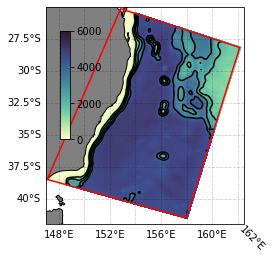

In [56]:
### Now same but for 'upstream' area

etaRangeMetric = [0, 315] #[115, 200]
xiRangeMetric = [0, 270] #[85, 150]

boxLo,boxLa = calc_boxSpatial(grid,etaRange=etaRangeMetric,xiRange=xiRangeMetric)
fig = plt.figure()
ax = plt.subplot(projection=ccrs.PlateCarree())
pcol_params={"cmap":"cmo.deep","vmin":0, "vmax":6000, "zorder":1}#, "add_colorbar":"False"}
cont_params={"colors":"black"}
plot_spatialMap(grid.h,pcol_kwargs=pcol_params, cont_kwargs=cont_params)
ax.plot(boxLo,boxLa, color='red')
# plt.tight_layout()

datelist = np.array(range(timeRange[0],timeRange[1],4))

for dates in datelist:
    filenameForecast=hisFilePath+prefixForecast+'0'+str(dates)+'.nc'
    filenameAnalysis=hisFilePath+prefixAnalysis+'0'+str(dates)+'.nc'
    filenameTruth   =truthFilePath+prefixTruth+'0'+str(dates)+'.nc'

    sshForecast=xr.open_dataset(filenameForecast).zeta.load()
    sshAnalysis=xr.open_dataset(filenameAnalysis).zeta.load()
    sshTruth   =xr.open_dataset(filenameTruth).zeta.load()
    sstForecast=xr.open_dataset(filenameForecast).temp.isel(s_rho=-1).load()
    sstAnalysis=xr.open_dataset(filenameAnalysis).temp.isel(s_rho=-1).load()
    sstTruth=xr.open_dataset(filenameTruth).temp.isel(s_rho=-1).load()
    # sst=xr.open_dataset(filenameForecast).temp.isel(s_rho=-1).load()

    filenamePert   =pertFilePath+prefixPert+'0'+str(dates)+'.nc'
    sshPert     = xr.open_dataset(filenamePert).zeta.load()
    sstPert     = xr.open_dataset(filenamePert).temp.isel(s_rho=-1).load()

    if dates == datelist[0]:
        ssh_metricForecast = indexMeanMetric(sshForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricAnalysis = indexMeanMetric(sshAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricTruth = indexMeanMetric(sshTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))

        sst_metricForecast = indexMeanMetric(sstForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricAnalysis = indexMeanMetric(sstAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricTruth = indexMeanMetric(sstTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))

        sst_metricPert = indexMeanMetric(sstPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricPert = indexMeanMetric(sshPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))

    elif dates != datelist[0]:
        temp = indexMeanMetric(sshForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricForecast = xr.merge([ssh_metricForecast, temp])
        temp = indexMeanMetric(sshAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricAnalysis = xr.merge([ssh_metricAnalysis, temp])
        temp = indexMeanMetric(sshTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricTruth = xr.merge([ssh_metricTruth, temp])
        temp = indexMeanMetric(sstForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricForecast = xr.merge([sst_metricForecast, temp])
        temp = indexMeanMetric(sstAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricAnalysis = xr.merge([sst_metricAnalysis, temp])
        temp = indexMeanMetric(sstTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricTruth = xr.merge([sst_metricTruth, temp])

        temp = indexMeanMetric(sstPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricPert = xr.merge([sst_metricPert, temp])
        temp = indexMeanMetric(sshPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricPert = xr.merge([ssh_metricPert, temp])

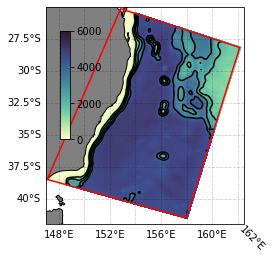

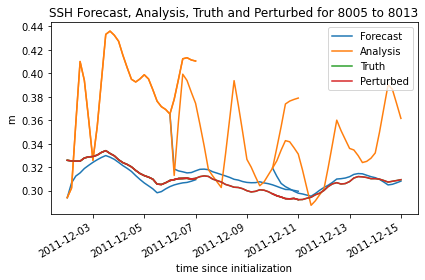

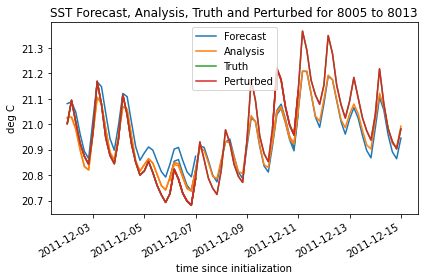

In [57]:
### Now same but for 'upstream' area

etaRangeMetric = [0, 315] #[115, 200]
xiRangeMetric = [0, 270] #[85, 150]

boxLo,boxLa = calc_boxSpatial(grid,etaRange=etaRangeMetric,xiRange=xiRangeMetric)
fig = plt.figure()
ax = plt.subplot(projection=ccrs.PlateCarree())
pcol_params={"cmap":"cmo.deep","vmin":0, "vmax":6000, "zorder":1}#, "add_colorbar":"False"}
cont_params={"colors":"black"}
plot_spatialMap(grid.h,pcol_kwargs=pcol_params, cont_kwargs=cont_params)
ax.plot(boxLo,boxLa, color='red')
# plt.tight_layout()

datelist = np.array(range(timeRange[0],timeRange[1],4))

for dates in datelist:
    filenameForecast=hisFilePath+prefixForecast+'0'+str(dates)+'.nc'
    filenameAnalysis=hisFilePath+prefixAnalysis+'0'+str(dates)+'.nc'
    filenameTruth   =truthFilePath+prefixTruth+'0'+str(dates)+'.nc'

    sshForecast=xr.open_dataset(filenameForecast).zeta.load()
    sshAnalysis=xr.open_dataset(filenameAnalysis).zeta.load()
    sshTruth   =xr.open_dataset(filenameTruth).zeta.load()
    sstForecast=xr.open_dataset(filenameForecast).temp.isel(s_rho=-1).load()
    sstAnalysis=xr.open_dataset(filenameAnalysis).temp.isel(s_rho=-1).load()
    sstTruth=xr.open_dataset(filenameTruth).temp.isel(s_rho=-1).load()
    # sst=xr.open_dataset(filenameForecast).temp.isel(s_rho=-1).load()

    filenamePert   =pertFilePath+prefixPert+'0'+str(dates)+'.nc'
    sshPert     = xr.open_dataset(filenamePert).zeta.load()
    sstPert     = xr.open_dataset(filenamePert).temp.isel(s_rho=-1).load()

    if dates == datelist[0]:
        ssh_metricForecast = indexMeanMetric(sshForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricAnalysis = indexMeanMetric(sshAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricTruth = indexMeanMetric(sshTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))

        sst_metricForecast = indexMeanMetric(sstForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricAnalysis = indexMeanMetric(sstAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricTruth = indexMeanMetric(sstTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))

        sst_metricPert = indexMeanMetric(sstPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricPert = indexMeanMetric(sshPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))

    elif dates != datelist[0]:
        temp = indexMeanMetric(sshForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricForecast = xr.merge([ssh_metricForecast, temp])
        temp = indexMeanMetric(sshAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricAnalysis = xr.merge([ssh_metricAnalysis, temp])
        temp = indexMeanMetric(sshTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricTruth = xr.merge([ssh_metricTruth, temp])
        temp = indexMeanMetric(sstForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricForecast = xr.merge([sst_metricForecast, temp])
        temp = indexMeanMetric(sstAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricAnalysis = xr.merge([sst_metricAnalysis, temp])
        temp = indexMeanMetric(sstTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricTruth = xr.merge([sst_metricTruth, temp])
        temp = indexMeanMetric(sstPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricPert = xr.merge([sst_metricPert, temp])
        temp = indexMeanMetric(sshPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricPert = xr.merge([ssh_metricPert, temp])

fig = plt.figure()
assimPeriod = datelist
ssh_metricForecast[str(assimPeriod[0])].plot.line("C0",label='Forecast')
ssh_metricAnalysis[str(assimPeriod[0])].plot.line("C1",label='Analysis')
ssh_metricTruth[str(assimPeriod[0])].plot.line("C2",label='Truth')
ssh_metricPert[str(assimPeriod[0])].plot.line("C3",label='Perturbed')

for assimPeriod in datelist[1:]:
    ssh_metricForecast[str(assimPeriod)].plot.line("C0",label='')
for assimPeriod in datelist:
    ssh_metricAnalysis[str(assimPeriod)].plot.line("C1",label='')
for assimPeriod in datelist:
    ssh_metricTruth[str(assimPeriod)].plot.line("C2",label='')
for assimPeriod in datelist:
    ssh_metricPert[str(assimPeriod)].plot.line("C3",label='')
plt.legend()
plt.title('SSH Forecast, Analysis, Truth and Perturbed for '+str(datelist[0])+' to '+str(datelist[-1]))
plt.ylabel('m')
plt.tight_layout()

fig = plt.figure()
assimPeriod = datelist
sst_metricForecast[str(assimPeriod[0])].plot.line("C0",label='Forecast')
sst_metricAnalysis[str(assimPeriod[0])].plot.line("C1",label='Analysis')
sst_metricTruth[str(assimPeriod[0])].plot.line("C2",label='Truth')
sst_metricPert[str(assimPeriod[0])].plot.line("C3",label='Perturbed')

for assimPeriod in datelist[1:]:
    sst_metricForecast[str(assimPeriod)].plot.line("C0",label='')
for assimPeriod in datelist:
    sst_metricAnalysis[str(assimPeriod)].plot.line("C1",label='')
for assimPeriod in datelist:
    sst_metricTruth[str(assimPeriod)].plot.line("C2",label='')
for assimPeriod in datelist:
    sst_metricPert[str(assimPeriod)].plot.line("C3",label='')
plt.legend()
plt.title('SST Forecast, Analysis, Truth and Perturbed for '+str(datelist[0])+' to '+str(datelist[-1]))
plt.ylabel('deg C')
plt.tight_layout()

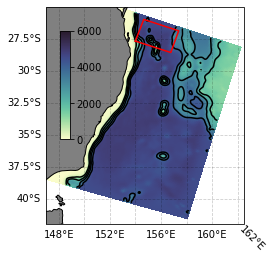

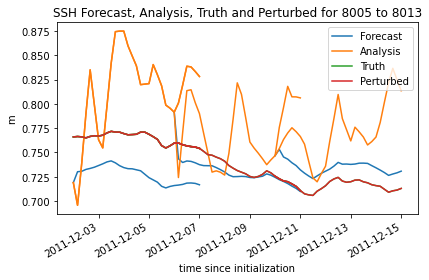

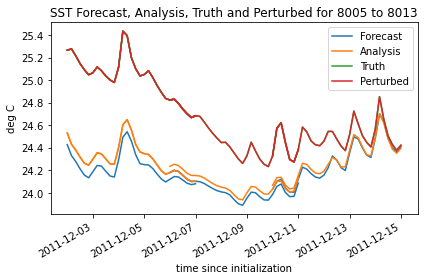

In [58]:
### Now same but for 'upstream' area

etaRangeMetric = [270, 310] #[115, 200]
xiRangeMetric = [75, 175] #[85, 150]

boxLo,boxLa = calc_boxSpatial(grid,etaRange=etaRangeMetric,xiRange=xiRangeMetric)
fig = plt.figure()
ax = plt.subplot(projection=ccrs.PlateCarree())
pcol_params={"cmap":"cmo.deep","vmin":0, "vmax":6000, "zorder":1}#, "add_colorbar":"False"}
cont_params={"colors":"black"}
plot_spatialMap(grid.h,pcol_kwargs=pcol_params, cont_kwargs=cont_params)
ax.plot(boxLo,boxLa, color='red')
# plt.tight_layout()

datelist = np.array(range(timeRange[0],timeRange[1],4))

for dates in datelist:
    filenameForecast=hisFilePath+prefixForecast+'0'+str(dates)+'.nc'
    filenameAnalysis=hisFilePath+prefixAnalysis+'0'+str(dates)+'.nc'
    filenameTruth   =truthFilePath+prefixTruth+'0'+str(dates)+'.nc'

    sshForecast=xr.open_dataset(filenameForecast).zeta.load()
    sshAnalysis=xr.open_dataset(filenameAnalysis).zeta.load()
    sshTruth   =xr.open_dataset(filenameTruth).zeta.load()
    sstForecast=xr.open_dataset(filenameForecast).temp.isel(s_rho=-1).load()
    sstAnalysis=xr.open_dataset(filenameAnalysis).temp.isel(s_rho=-1).load()
    sstTruth=xr.open_dataset(filenameTruth).temp.isel(s_rho=-1).load()
    # sst=xr.open_dataset(filenameForecast).temp.isel(s_rho=-1).load()

    filenamePert   =pertFilePath+prefixPert+'0'+str(dates)+'.nc'
    sshPert     = xr.open_dataset(filenamePert).zeta.load()
    sstPert     = xr.open_dataset(filenamePert).temp.isel(s_rho=-1).load()

    if dates == datelist[0]:
        ssh_metricForecast = indexMeanMetric(sshForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricAnalysis = indexMeanMetric(sshAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricTruth = indexMeanMetric(sshTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))

        sst_metricForecast = indexMeanMetric(sstForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricAnalysis = indexMeanMetric(sstAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricTruth = indexMeanMetric(sstTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))

        sst_metricPert = indexMeanMetric(sstPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricPert = indexMeanMetric(sshPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))

    elif dates != datelist[0]:
        temp = indexMeanMetric(sshForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricForecast = xr.merge([ssh_metricForecast, temp])
        temp = indexMeanMetric(sshAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricAnalysis = xr.merge([ssh_metricAnalysis, temp])
        temp = indexMeanMetric(sshTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricTruth = xr.merge([ssh_metricTruth, temp])
        temp = indexMeanMetric(sstForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricForecast = xr.merge([sst_metricForecast, temp])
        temp = indexMeanMetric(sstAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricAnalysis = xr.merge([sst_metricAnalysis, temp])
        temp = indexMeanMetric(sstTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricTruth = xr.merge([sst_metricTruth, temp])
        temp = indexMeanMetric(sstPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricPert = xr.merge([sst_metricPert, temp])
        temp = indexMeanMetric(sshPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricPert = xr.merge([ssh_metricPert, temp])

fig = plt.figure()
assimPeriod = datelist
ssh_metricForecast[str(assimPeriod[0])].plot.line("C0",label='Forecast')
ssh_metricAnalysis[str(assimPeriod[0])].plot.line("C1",label='Analysis')
ssh_metricTruth[str(assimPeriod[0])].plot.line("C2",label='Truth')
ssh_metricPert[str(assimPeriod[0])].plot.line("C3",label='Perturbed')

for assimPeriod in datelist[1:]:
    ssh_metricForecast[str(assimPeriod)].plot.line("C0",label='')
for assimPeriod in datelist:
    ssh_metricAnalysis[str(assimPeriod)].plot.line("C1",label='')
for assimPeriod in datelist:
    ssh_metricTruth[str(assimPeriod)].plot.line("C2",label='')
for assimPeriod in datelist:
    ssh_metricPert[str(assimPeriod)].plot.line("C3",label='')
plt.legend()
plt.title('SSH Forecast, Analysis, Truth and Perturbed for '+str(datelist[0])+' to '+str(datelist[-1]))
plt.ylabel('m')
plt.tight_layout()

fig = plt.figure()
assimPeriod = datelist
sst_metricForecast[str(assimPeriod[0])].plot.line("C0",label='Forecast')
sst_metricAnalysis[str(assimPeriod[0])].plot.line("C1",label='Analysis')
sst_metricTruth[str(assimPeriod[0])].plot.line("C2",label='Truth')
sst_metricPert[str(assimPeriod[0])].plot.line("C3",label='Perturbed')

for assimPeriod in datelist[1:]:
    sst_metricForecast[str(assimPeriod)].plot.line("C0",label='')
for assimPeriod in datelist:
    sst_metricAnalysis[str(assimPeriod)].plot.line("C1",label='')
for assimPeriod in datelist:
    sst_metricTruth[str(assimPeriod)].plot.line("C2",label='')
for assimPeriod in datelist:
    sst_metricPert[str(assimPeriod)].plot.line("C3",label='')
plt.legend()
plt.title('SST Forecast, Analysis, Truth and Perturbed for '+str(datelist[0])+' to '+str(datelist[-1]))
plt.ylabel('deg C')
plt.tight_layout()

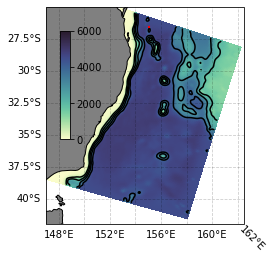

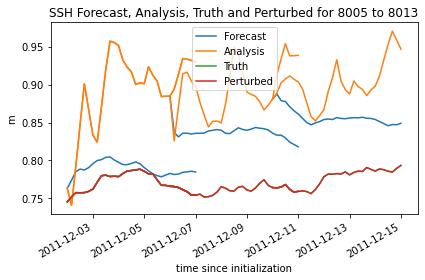

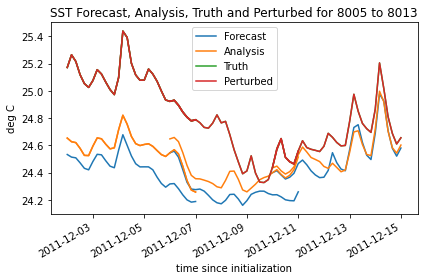

In [59]:
### Now same but for 'upstream' area

etaRangeMetric = [300, 301] #[115, 200]
xiRangeMetric = [99, 100] #[85, 150]

boxLo,boxLa = calc_boxSpatial(grid,etaRange=etaRangeMetric,xiRange=xiRangeMetric)
fig = plt.figure()
ax = plt.subplot(projection=ccrs.PlateCarree())
pcol_params={"cmap":"cmo.deep","vmin":0, "vmax":6000, "zorder":1}#, "add_colorbar":"False"}
cont_params={"colors":"black"}
plot_spatialMap(grid.h,pcol_kwargs=pcol_params, cont_kwargs=cont_params)
ax.plot(boxLo,boxLa, color='red')
# plt.tight_layout()

datelist = np.array(range(timeRange[0],timeRange[1],4))

for dates in datelist:
    filenameForecast=hisFilePath+prefixForecast+'0'+str(dates)+'.nc'
    filenameAnalysis=hisFilePath+prefixAnalysis+'0'+str(dates)+'.nc'
    filenameTruth   =truthFilePath+prefixTruth+'0'+str(dates)+'.nc'

    sshForecast=xr.open_dataset(filenameForecast).zeta.load()
    sshAnalysis=xr.open_dataset(filenameAnalysis).zeta.load()
    sshTruth   =xr.open_dataset(filenameTruth).zeta.load()
    sstForecast=xr.open_dataset(filenameForecast).temp.isel(s_rho=-1).load()
    sstAnalysis=xr.open_dataset(filenameAnalysis).temp.isel(s_rho=-1).load()
    sstTruth=xr.open_dataset(filenameTruth).temp.isel(s_rho=-1).load()
    # sst=xr.open_dataset(filenameForecast).temp.isel(s_rho=-1).load()

    filenamePert   =pertFilePath+prefixPert+'0'+str(dates)+'.nc'
    sshPert     = xr.open_dataset(filenamePert).zeta.load()
    sstPert     = xr.open_dataset(filenamePert).temp.isel(s_rho=-1).load()

    if dates == datelist[0]:
        ssh_metricForecast = indexMeanMetric(sshForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricAnalysis = indexMeanMetric(sshAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricTruth = indexMeanMetric(sshTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))

        sst_metricForecast = indexMeanMetric(sstForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricAnalysis = indexMeanMetric(sstAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricTruth = indexMeanMetric(sstTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))

        sst_metricPert = indexMeanMetric(sstPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricPert = indexMeanMetric(sshPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))

    elif dates != datelist[0]:
        temp = indexMeanMetric(sshForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricForecast = xr.merge([ssh_metricForecast, temp])
        temp = indexMeanMetric(sshAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricAnalysis = xr.merge([ssh_metricAnalysis, temp])
        temp = indexMeanMetric(sshTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricTruth = xr.merge([ssh_metricTruth, temp])
        temp = indexMeanMetric(sstForecast, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricForecast = xr.merge([sst_metricForecast, temp])
        temp = indexMeanMetric(sstAnalysis, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricAnalysis = xr.merge([sst_metricAnalysis, temp])
        temp = indexMeanMetric(sstTruth, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricTruth = xr.merge([sst_metricTruth, temp])
        temp = indexMeanMetric(sstPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        sst_metricPert = xr.merge([sst_metricPert, temp])
        temp = indexMeanMetric(sshPert, etaRange=etaRangeMetric, xiRange=xiRangeMetric).to_dataset(name = str(dates))
        ssh_metricPert = xr.merge([ssh_metricPert, temp])

fig = plt.figure()
assimPeriod = datelist
ssh_metricForecast[str(assimPeriod[0])].plot.line("C0",label='Forecast')
ssh_metricAnalysis[str(assimPeriod[0])].plot.line("C1",label='Analysis')
ssh_metricTruth[str(assimPeriod[0])].plot.line("C2",label='Truth')
ssh_metricPert[str(assimPeriod[0])].plot.line("C3",label='Perturbed')

for assimPeriod in datelist[1:]:
    ssh_metricForecast[str(assimPeriod)].plot.line("C0",label='')
for assimPeriod in datelist:
    ssh_metricAnalysis[str(assimPeriod)].plot.line("C1",label='')
for assimPeriod in datelist:
    ssh_metricTruth[str(assimPeriod)].plot.line("C2",label='')
for assimPeriod in datelist:
    ssh_metricPert[str(assimPeriod)].plot.line("C3",label='')
plt.legend()
plt.title('SSH Forecast, Analysis, Truth and Perturbed for '+str(datelist[0])+' to '+str(datelist[-1]))
plt.ylabel('m')
plt.tight_layout()

fig = plt.figure()
assimPeriod = datelist
sst_metricForecast[str(assimPeriod[0])].plot.line("C0",label='Forecast')
sst_metricAnalysis[str(assimPeriod[0])].plot.line("C1",label='Analysis')
sst_metricTruth[str(assimPeriod[0])].plot.line("C2",label='Truth')
sst_metricPert[str(assimPeriod[0])].plot.line("C3",label='Perturbed')

for assimPeriod in datelist[1:]:
    sst_metricForecast[str(assimPeriod)].plot.line("C0",label='')
for assimPeriod in datelist:
    sst_metricAnalysis[str(assimPeriod)].plot.line("C1",label='')
for assimPeriod in datelist:
    sst_metricTruth[str(assimPeriod)].plot.line("C2",label='')
for assimPeriod in datelist:
    sst_metricPert[str(assimPeriod)].plot.line("C3",label='')
plt.legend()
plt.title('SST Forecast, Analysis, Truth and Perturbed for '+str(datelist[0])+' to '+str(datelist[-1]))
plt.ylabel('deg C')
plt.tight_layout()

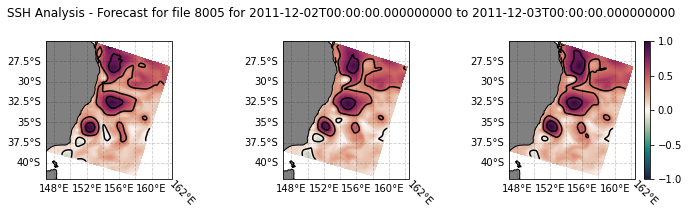

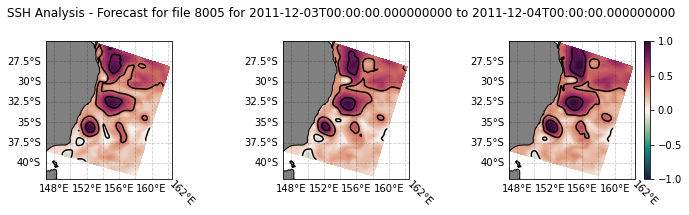

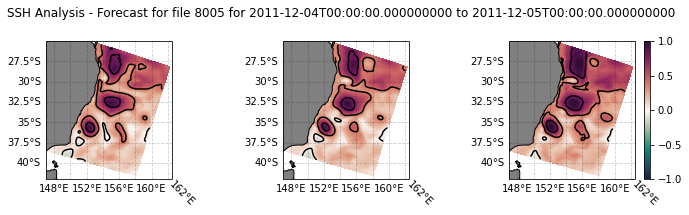

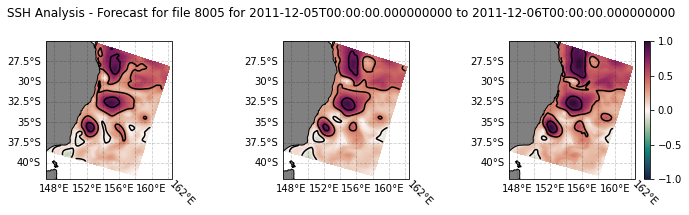

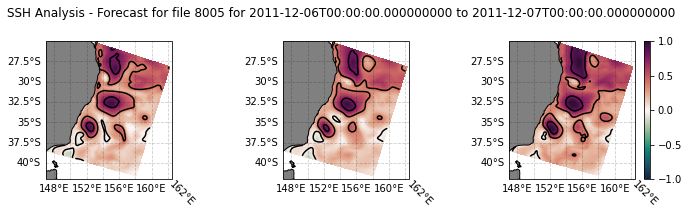

...

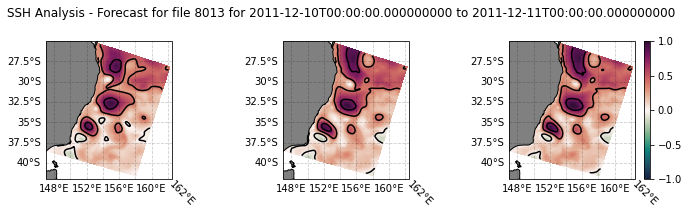

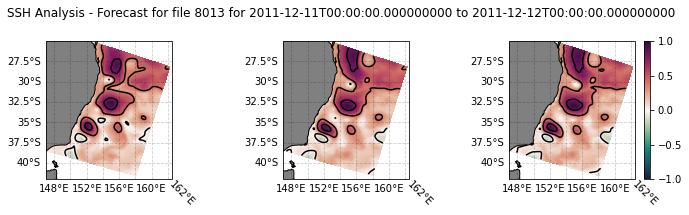

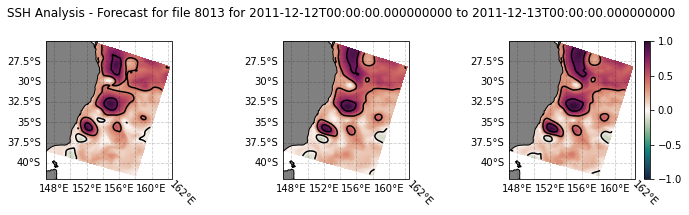

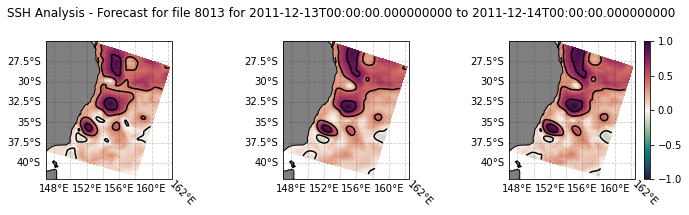

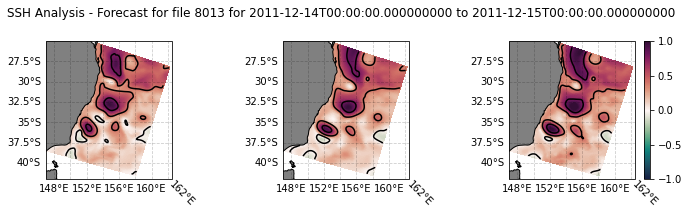

In [60]:
datelist = np.array(range(timeRange[0],timeRange[1],4))

for dates in datelist:
    filenameForecast=hisFilePath+prefixForecast+'0'+str(dates)+'.nc'
    filenameAnalysis=hisFilePath+prefixAnalysis+'0'+str(dates)+'.nc'
    filenameTruth=truthFilePath+prefixTruth+'0'+str(dates)+'.nc'

    sshForecast=xr.open_dataset(filenameForecast).zeta.load()
    sshAnalysis=xr.open_dataset(filenameAnalysis).zeta.load()
    sshTruth=xr.open_dataset(filenameTruth).zeta.load()

    for tChunk in range(0,timeOutputMax,timeOutputs):

        fig, axes = plt.subplots(ncols=3, figsize=(10, 3), subplot_kw={'projection': ccrs.PlateCarree()})
        
        toPlotData = sshTruth.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
        ax = axes[0]
        ax.set_extent([147, 162.5, -42, -25])
        feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
        im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)
        toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
        gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        gl.right_labels = False
        gl.top_labels = False     
        im.set_clim([-1,1]) 

        toPlotData = sshForecast.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
        ax = axes[1]            
        ax.set_extent([147, 162.5, -42, -25])
        feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
        im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)
        toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
        gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        gl.right_labels = False
        gl.top_labels = False
        im.set_clim([-1,1]) 

        toPlotData = sshAnalysis.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
        ax = axes[2]
        ax.set_extent([147, 162.5, -42, -25])
        feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
        im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)
        toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
        gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        gl.right_labels = False
        gl.top_labels = False
        im.set_clim([-1,1]) 

        plt.colorbar(im)
        date1=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk])
        date2=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk+timeOutputs])
        fig.suptitle('SSH Analysis - Forecast for file '+str(dates)+' for '+date1+' to '+date2)
        plt.ylabel('deg C')
        plt.tight_layout()
        figName = outFigurePath+'SSHdiff_'+str(dates)+'_day'+str(int(tChunk/timeOutputs+1))+'.png'
        # plt.savefig(figName,format='png',bbox_inches='tight')

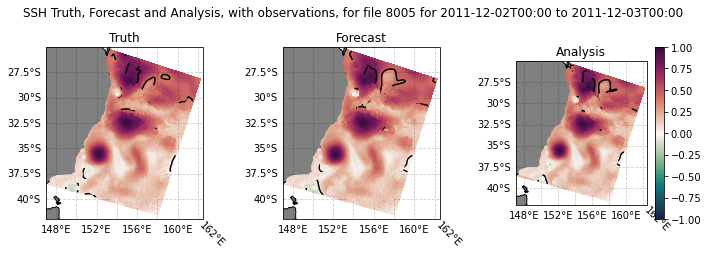

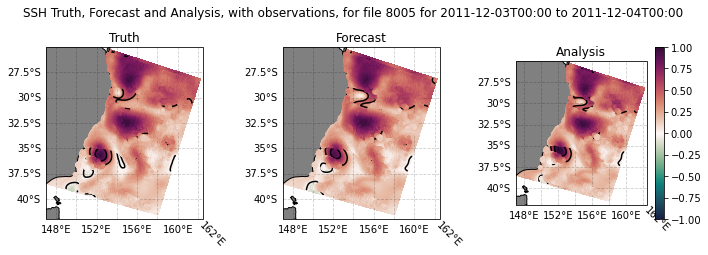

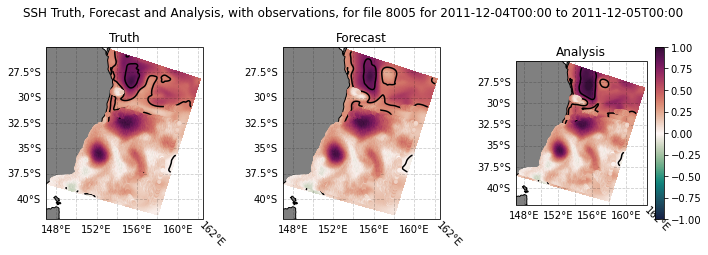

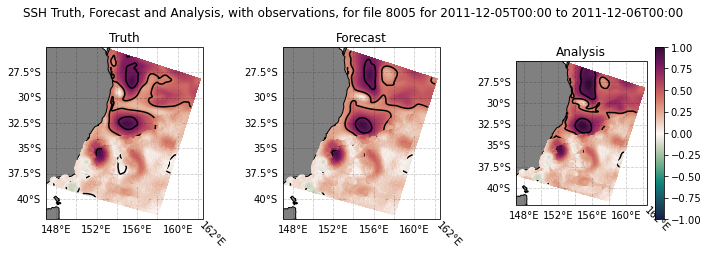

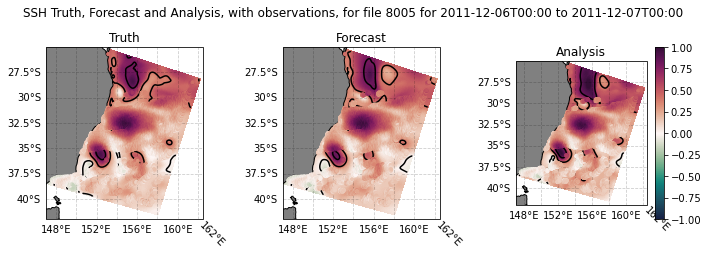

...

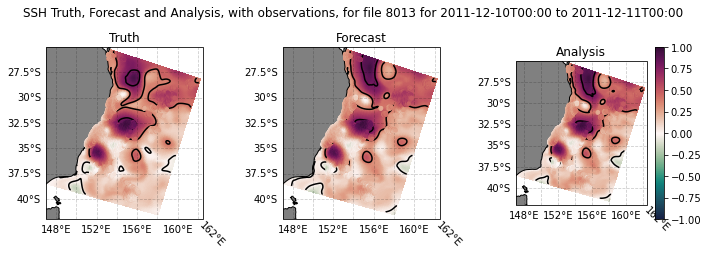

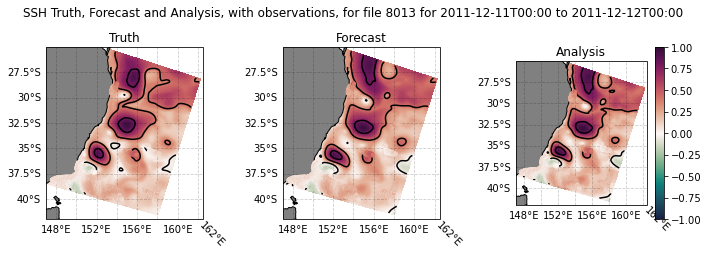

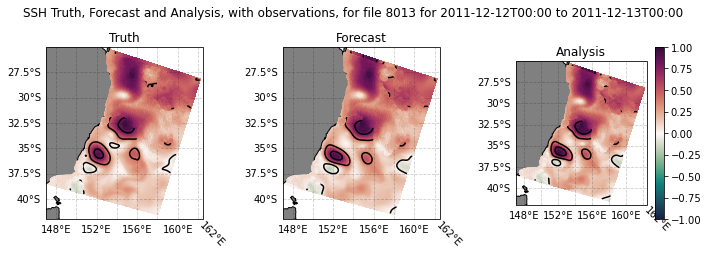

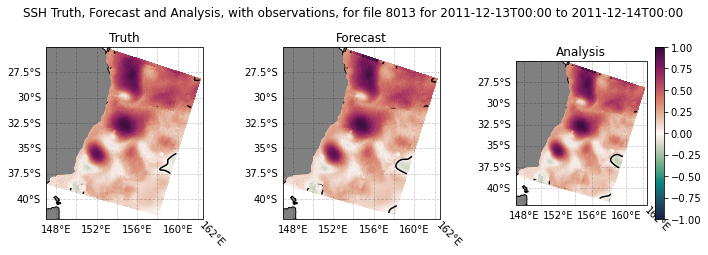

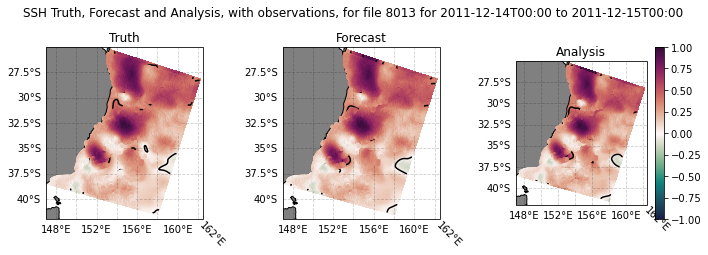

In [62]:
datelist = np.array(range(timeRange[0],timeRange[1],4))

provValue=405

for dates in datelist:
    filenameForecast=hisFilePath+prefixForecast+'0'+str(dates)+'.nc'
    filenameAnalysis=hisFilePath+prefixAnalysis+'0'+str(dates)+'.nc'
    filenameTruth=truthFilePath+prefixTruth+'0'+str(dates)+'.nc'

    sshForecast=xr.open_dataset(filenameForecast).zeta.load()
    sshAnalysis=xr.open_dataset(filenameAnalysis).zeta.load()
    sshTruth=xr.open_dataset(filenameTruth).zeta.load()

    filenameObs=obsFilePath+prefixObs+''+str(dates)+'.nc'
    obs=xr.open_dataset(filenameObs).load()

    for tChunk in range(0,timeOutputMax,timeOutputs):
        fig, axes = plt.subplots(ncols=3, figsize=(10, 3.5), subplot_kw={'projection': ccrs.PlateCarree()})

        time1=sshTruth.coords['ocean_time'].values[tChunk]
        time2=sshTruth.coords['ocean_time'].values[tChunk+timeOutputs]
        time1sd=datestring_to_serial_day(time1) 
        time2sd=datestring_to_serial_day(time2) 
        
        toPlotData = sshTruth.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
        ax = axes[0]
        ax.set_extent([147, 162.5, -42, -25])
        feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
        im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)
        toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
        v=obs.obs_value.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        lo=obs.obs_lon.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        la=obs.obs_lat.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        t=obs.obs_time.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        sc = ax.scatter(x=lo,y=la,c=v,marker='.', cmap = cmaps.cmocean_curl, zorder=10)
        gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        gl.right_labels = False
        gl.top_labels = False     
        im.set_clim([-1,1])
        sc.set_clim([-1,1])
        ax.set_title('Truth')

        toPlotData = sshForecast.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
        ax = axes[1]            
        ax.set_extent([147, 162.5, -42, -25])
        feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
        im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)
        toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
        v=obs.obs_value.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        lo=obs.obs_lon.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        la=obs.obs_lat.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        t=obs.obs_time.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        sc = ax.scatter(x=lo,y=la,c=v,marker='.', cmap = cmaps.cmocean_curl, zorder=10)
        gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        gl.right_labels = False
        gl.top_labels = False     
        im.set_clim([-1,1])
        sc.set_clim([-1,1])
        ax.set_title('Forecast')


        toPlotData = sshAnalysis.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
        ax = axes[2]
        ax.set_extent([147, 162.5, -42, -25])
        feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
        im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)
        toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
        v=obs.obs_value.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        lo=obs.obs_lon.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        la=obs.obs_lat.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        t=obs.obs_time.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        sc = ax.scatter(x=lo,y=la,c=v,marker='.', cmap = cmaps.cmocean_curl, zorder=10)
        gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        gl.right_labels = False
        gl.top_labels = False     
        im.set_clim([-1,1])
        sc.set_clim([-1,1])
        ax.set_title('Analysis')


        plt.colorbar(im)
        date1=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk])
        date2=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk+timeOutputs])
        fig.suptitle('SSH Truth, Forecast and Analysis, with observations, for file '+str(dates)+' for '+date1[:-13]+' to '+date2[:-13])
        plt.ylabel('m')
        plt.tight_layout()
        figName = outFigurePath+'SSHdiff_'+str(dates)+'_day'+str(int(tChunk/timeOutputs+1))+'.png'
        # plt.savefig(figName,format='png',bbox_inches='tight')






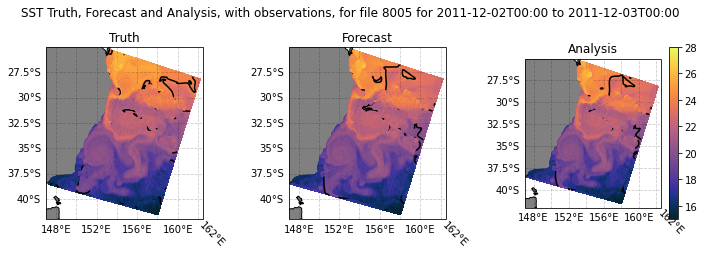

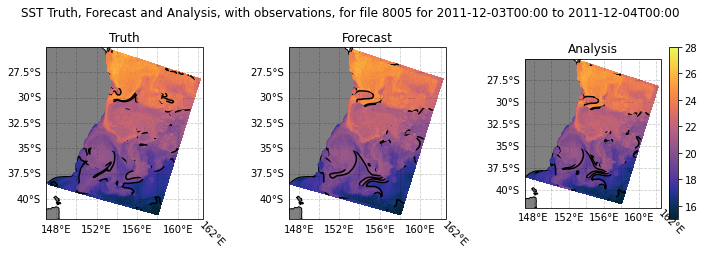

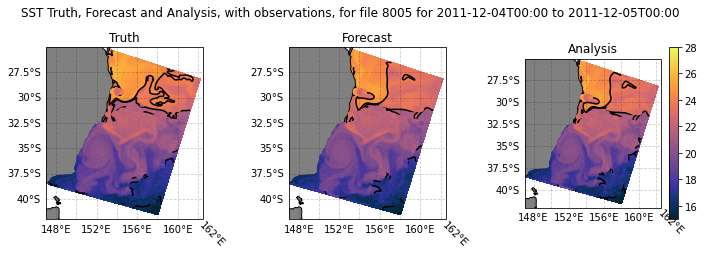

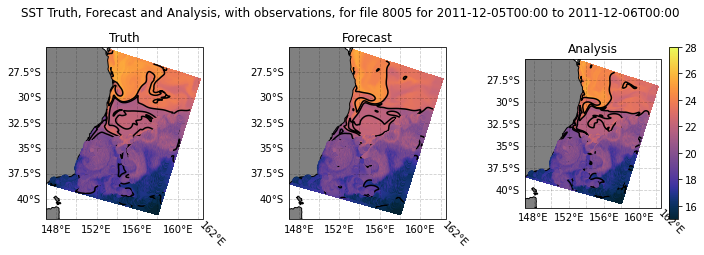

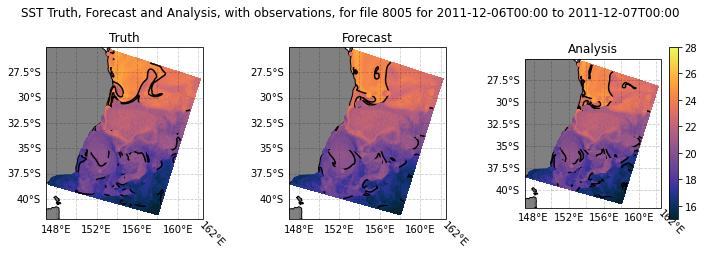

...

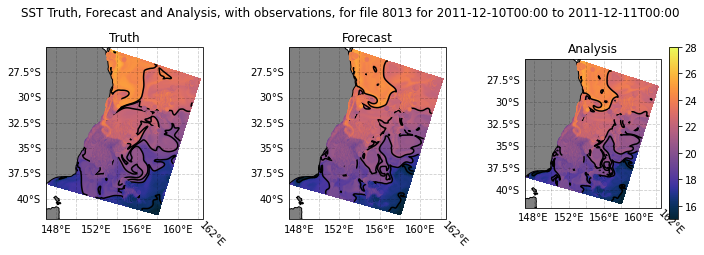

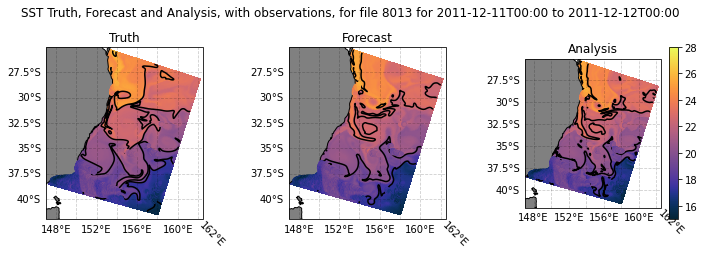

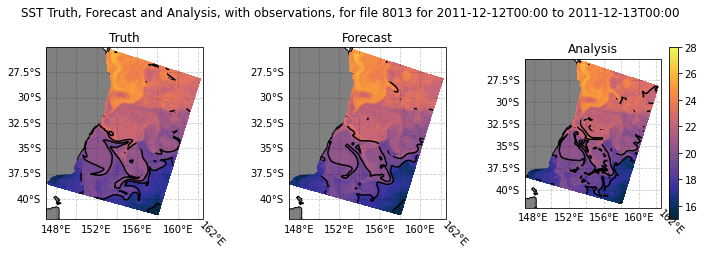

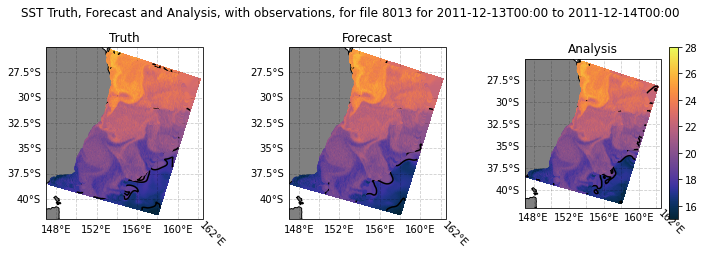

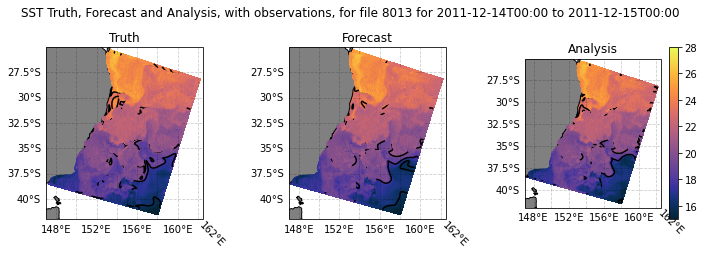

In [63]:
datelist = np.array(range(timeRange[0],timeRange[1],4))

provValue=340

for dates in datelist:
    filenameForecast=hisFilePath+prefixForecast+'0'+str(dates)+'.nc'
    filenameAnalysis=hisFilePath+prefixAnalysis+'0'+str(dates)+'.nc'
    filenameTruth=truthFilePath+prefixTruth+'0'+str(dates)+'.nc'

    sstForecast=xr.open_dataset(filenameForecast).temp.isel(s_rho=-1).load()
    sstAnalysis=xr.open_dataset(filenameAnalysis).temp.isel(s_rho=-1).load()
    sstTruth=xr.open_dataset(filenameTruth).temp.isel(s_rho=-1).load()

    filenameObs=obsFilePath+prefixObs+''+str(dates)+'.nc'
    obs=xr.open_dataset(filenameObs).load()

    for tChunk in range(0,timeOutputMax,timeOutputs):
        fig, axes = plt.subplots(ncols=3, figsize=(10, 3.5), subplot_kw={'projection': ccrs.PlateCarree()})

        time1=sstTruth.coords['ocean_time'].values[tChunk]
        time2=sstTruth.coords['ocean_time'].values[tChunk+timeOutputs]
        time1sd=datestring_to_serial_day(time1) 
        time2sd=datestring_to_serial_day(time2) 
        
        toPlotData = sstTruth.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
        ax = axes[0]
        ax.set_extent([147, 162.5, -42, -25])
        feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
        im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.thermal, ax=ax, add_colorbar=False)
        toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
        v=obs.obs_value.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        lo=obs.obs_lon.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        la=obs.obs_lat.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        t=obs.obs_time.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        sc = ax.scatter(x=lo,y=la,c=v,marker='.', cmap = cmaps.cmocean_thermal, zorder=10)
        gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        gl.right_labels = False
        gl.top_labels = False     
        im.set_clim([15,28])
        sc.set_clim([15,28])
        ax.set_title('Truth')

        toPlotData = sstForecast.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
        ax = axes[1]            
        ax.set_extent([147, 162.5, -42, -25])
        feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
        im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.thermal, ax=ax, add_colorbar=False)
        toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
        v=obs.obs_value.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        lo=obs.obs_lon.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        la=obs.obs_lat.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        t=obs.obs_time.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        sc = ax.scatter(x=lo,y=la,c=v,marker='.', cmap = cmaps.cmocean_thermal, zorder=10)
        gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        gl.right_labels = False
        gl.top_labels = False     
        im.set_clim([15,28])
        sc.set_clim([15,28])
        ax.set_title('Forecast')


        toPlotData = sstAnalysis.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
        ax = axes[2]
        ax.set_extent([147, 162.5, -42, -25])
        feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
        im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.thermal, ax=ax, add_colorbar=False)
        toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
        v=obs.obs_value.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        lo=obs.obs_lon.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        la=obs.obs_lat.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        t=obs.obs_time.where(obs.obs_provenance==provValue).where((obs.obs_time>time1sd) & (obs.obs_time<time2sd), drop=True)
        sc = ax.scatter(x=lo,y=la,c=v,marker='.', cmap = cmaps.cmocean_thermal, zorder=10)
        gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        gl.right_labels = False
        gl.top_labels = False     
        im.set_clim([15,28])
        sc.set_clim([15,28])
        ax.set_title('Analysis')


        plt.colorbar(im)
        date1=np.datetime_as_string(sstForecast.coords['ocean_time'].values[tChunk])
        date2=np.datetime_as_string(sstForecast.coords['ocean_time'].values[tChunk+timeOutputs])
        fig.suptitle('SST Truth, Forecast and Analysis, with observations, for file '+str(dates)+' for '+date1[:-13]+' to '+date2[:-13])
        plt.ylabel('deg C')
        plt.tight_layout()
        figName = outFigurePath+'SSTdiff_'+str(dates)+'_day'+str(int(tChunk/timeOutputs+1))+'.png'
        # plt.savefig(figName,format='png',bbox_inches='tight')



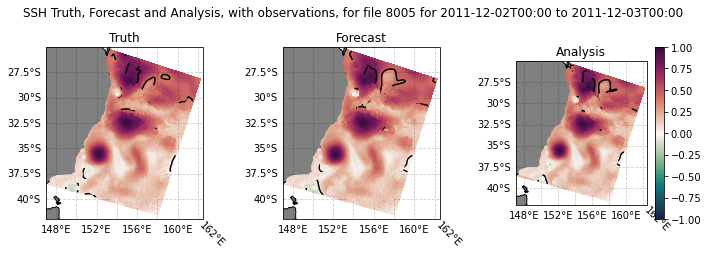

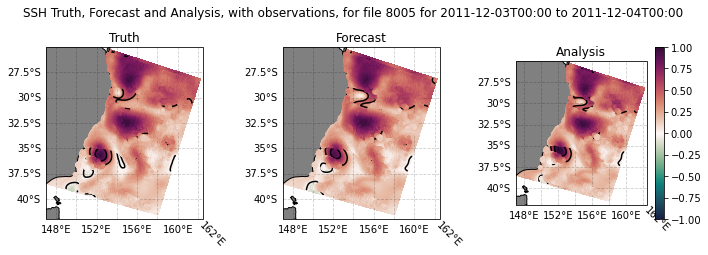

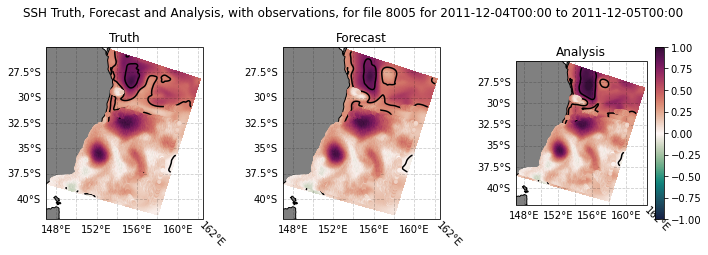

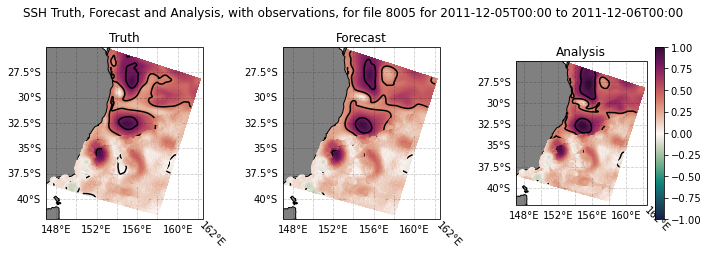

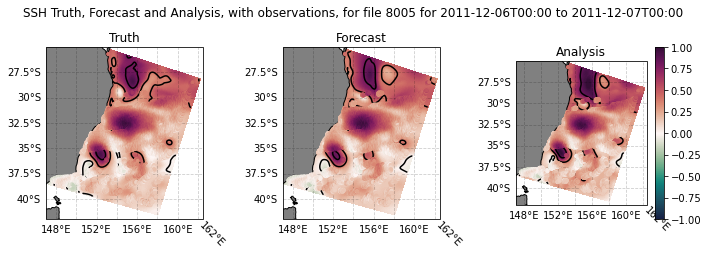

...

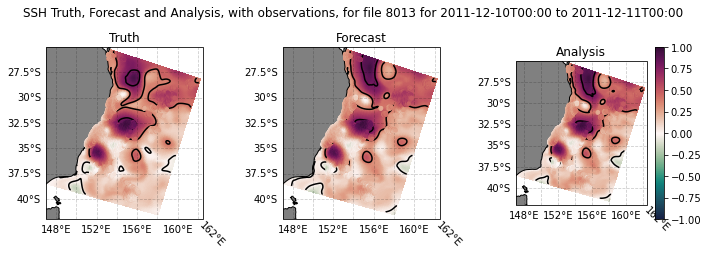

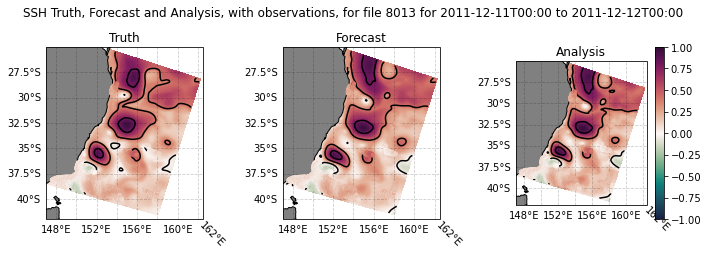

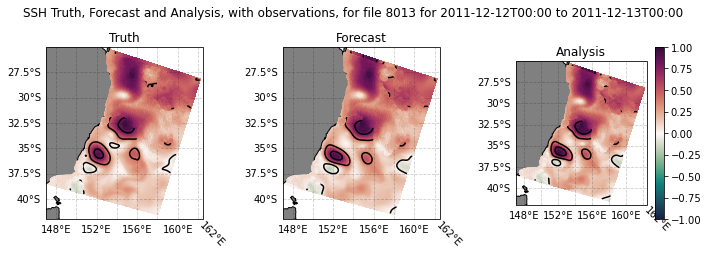

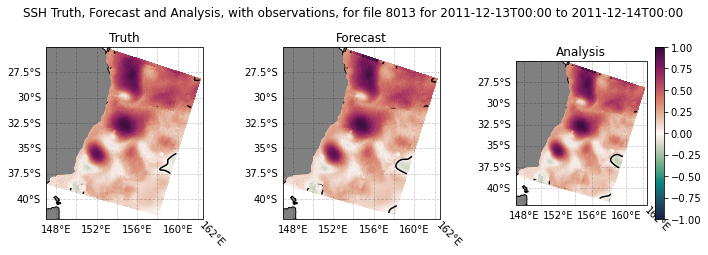

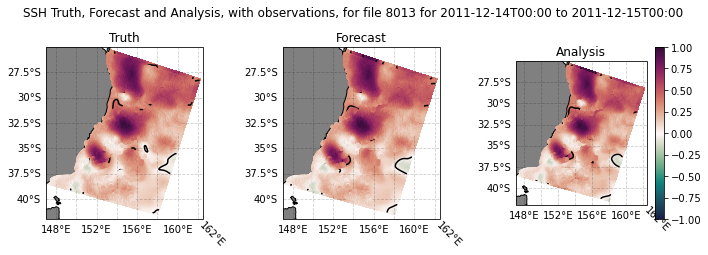

In [64]:
datelist = np.array(range(timeRange[0],timeRange[1],4))

provValue=405

for dates in datelist:
    filenameForecast=hisFilePath+prefixForecast+'0'+str(dates)+'.nc'
    filenameAnalysis=hisFilePath+prefixAnalysis+'0'+str(dates)+'.nc'
    filenameTruth=truthFilePath+prefixTruth+'0'+str(dates)+'.nc'

    sshForecast=xr.open_dataset(filenameForecast).zeta.load()
    sshAnalysis=xr.open_dataset(filenameAnalysis).zeta.load()
    sshTruth=xr.open_dataset(filenameTruth).zeta.load()

    filenameMod=modFilePath+prefixMod+'0'+str(dates)+'.nc'
    mod=xr.open_dataset(filenameMod).load()

    for tChunk in range(0,timeOutputMax,timeOutputs):
        fig, axes = plt.subplots(ncols=3, figsize=(10, 3.5), subplot_kw={'projection': ccrs.PlateCarree()})

        time1=sshTruth.coords['ocean_time'].values[tChunk]
        time2=sshTruth.coords['ocean_time'].values[tChunk+timeOutputs]
        time1sd=datestring_to_serial_day(time1) 
        time2sd=datestring_to_serial_day(time2) 
        
        toPlotData = sshTruth.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
        ax = axes[0]
        ax.set_extent([147, 162.5, -42, -25])
        feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
        im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)
        toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
        v=mod.obs_value.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
        lo=mod.obs_lon.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
        la=mod.obs_lat.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
        t=mod.obs_time.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
        sc = ax.scatter(x=lo,y=la,c=v,marker='.', cmap = cmaps.cmocean_curl, zorder=10)
        gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        gl.right_labels = False
        gl.top_labels = False     
        im.set_clim([-1,1])
        sc.set_clim([-1,1])
        ax.set_title('Truth')

        toPlotData = sshForecast.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
        ax = axes[1]            
        ax.set_extent([147, 162.5, -42, -25])
        feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
        im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)
        toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
        v=mod.obs_value.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
        lo=mod.obs_lon.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
        la=mod.obs_lat.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
        t=mod.obs_time.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
        sc = ax.scatter(x=lo,y=la,c=v,marker='.', cmap = cmaps.cmocean_curl, zorder=10)
        gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        gl.right_labels = False
        gl.top_labels = False     
        im.set_clim([-1,1])
        sc.set_clim([-1,1])
        ax.set_title('Forecast')


        toPlotData = sshAnalysis.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
        ax = axes[2]
        ax.set_extent([147, 162.5, -42, -25])
        feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
        im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)
        toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
        v=mod.obs_value.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
        lo=mod.obs_lon.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
        la=mod.obs_lat.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
        t=mod.obs_time.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
        sc = ax.scatter(x=lo,y=la,c=v,marker='.', cmap = cmaps.cmocean_curl, zorder=10)
        gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        gl.right_labels = False
        gl.top_labels = False     
        im.set_clim([-1,1])
        sc.set_clim([-1,1])
        ax.set_title('Analysis')


        plt.colorbar(im)
        date1=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk])
        date2=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk+timeOutputs])
        fig.suptitle('SSH Truth, Forecast and Analysis, with observations, for file '+str(dates)+' for '+date1[:-13]+' to '+date2[:-13])
        plt.ylabel('m')
        plt.tight_layout()
        figName = outFigurePath+'SSHdiff_'+str(dates)+'_day'+str(int(tChunk/timeOutputs+1))+'.png'
        # plt.savefig(figName,format='png',bbox_inches='tight')






In [65]:
mod

<xarray.Dataset>
Dimensions:          (Minner: 15, Ninner: 14, Nouter: 1, Nouter+1: 2, cost_var: 12, datum: 251106, datum+1: 251107, state_var: 11, survey: 5)
Dimensions without coordinates: Minner, Ninner, Nouter, Nouter+1, cost_var, datum, datum+1, state_var, survey
Data variables: (12/66)
    outer            int32 1
    inner            int32 14
    Nobs             (survey) int32 23674 11774 46030 97774 71854
    Nused_obs        (state_var) int32 125553 0 0 0 0 125553 0 0 0 0 0
    obs_mean         (state_var) float64 0.3746 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    obs_std          (state_var) float64 0.2535 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    ...               ...
    Hbk              (Nouter, datum) float64 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    Jb0              (Nouter+1) float64 0.0 21.83
    vcglwk           (Nouter, Minner, datum+1) float64 -9.965e-06 ... 0.0
    vcglev           (Nouter, Ninner, datum+1) float64 0.0 0.0 0.0 ... 0.0 0.0
    zcglwk           (Nouter, Minner, datum+1) float64 -9.965e-06 ... 0.0
    TLmodVal_S       (Nouter, Ninner, datum) float64 -1.617e+04 ... 1.117e+04
Attributes: (12/15)
    type:              ROMS/TOMS 4D-Var output observation processing file
    Algorithm:         RBL4DVAR
    obs_file:          obs.nc
    state_variables:   \n1: free-surface (m) \n2: vertically integrated u-mom...
    svn_url:           https://github.com/powellb/uhroms.git/trunk
    svn_rev:           712
    ...                ...
    os:                Linux
    cpu:               x86_64
    compiler_system:   ifort
    compiler_command:  /apps/openmpi/4.0.2/bin/mpif90
    compiler_flags:    -fp-model precise -heap-arrays -ip -O3 -traceback -che...
    history:           ROMS/TOMS, Version 3.9, Saturday - July 3, 2021 -  5:3...

<ipython-input-66-105a72b44841>:19: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  ax.plot(t, v, "C0", marker='.', markersize=1, lineStyle='None',zorder=10)
<ipython-input-66-105a72b44841>:20: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  ax.plot(t, vi, "C1", marker='.', markersize=5, lineStyle='None',zorder=5)
<ipython-input-66-105a72b44841>:21: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  ax.plot(t, vobs, "C2", marker='.', markersize=10, lineStyle='None',zorder=1)
<ipython-input-66-105a72b44841>:19: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  ax.plot(t, v, "C0", marker='.', markersize=1, lineStyle='None',zorder=10)
<ipython-inpu

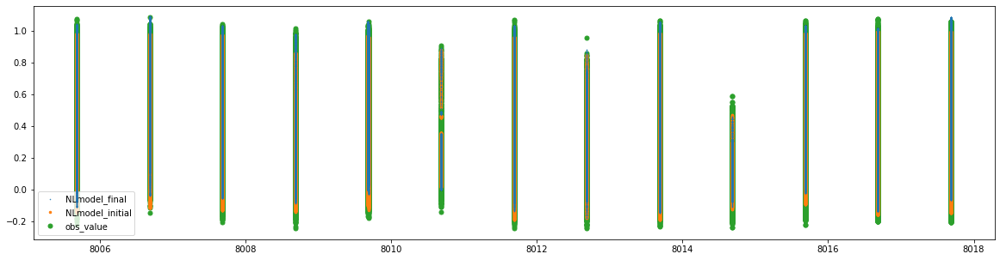

In [66]:
pRange=(405)


fig = plt.figure(figsize=(20,5))
ax = plt.axes()

for dates in datelist:

    filenameMod=modFilePath+prefixMod+'0'+str(dates)+'.nc'
    mod=xr.open_dataset(filenameMod).load()

    v=mod.NLmodel_final.where(mod.obs_provenance==pRange)
    vi=mod.NLmodel_initial.where(mod.obs_provenance==pRange)
    vobs=mod.obs_value.where(mod.obs_provenance==pRange)
    lo=mod.obs_lon.where(mod.obs_provenance==pRange)
    la=mod.obs_lat.where(mod.obs_provenance==pRange)
    t=mod.obs_time.where(mod.obs_provenance==pRange)
    
    ax.plot(t, v, "C0", marker='.', markersize=1, lineStyle='None',zorder=10)
    ax.plot(t, vi, "C1", marker='.', markersize=5, lineStyle='None',zorder=5)
    ax.plot(t, vobs, "C2", marker='.', markersize=10, lineStyle='None',zorder=1)
ax.plot(t, v, "C0", marker='.', markersize=1, lineStyle='None',label='NLmodel_final',zorder=10)
ax.plot(t, vi, "C1", marker='.', markersize=5, lineStyle='None',label='NLmodel_initial',zorder=5)
ax.plot(t, vobs, "C2", marker='.', markersize=10, lineStyle='None',label='obs_value',zorder=1)
ax.legend()
print(v.mean())


    # pRange=(340)
    # v=mod.NLmodel_final.where(mod.obs_provenance==pRange)
    # vi=mod.NLmodel_initial.where(mod.obs_provenance==pRange)
    # vobs=mod.obs_value.where(mod.obs_provenance==pRange)
    # lo=mod.obs_lon.where(mod.obs_provenance==pRange)
    # la=mod.obs_lat.where(mod.obs_provenance==pRange)
    # t=mod.obs_time.where(mod.obs_provenance==pRange)
    # fig = plt.figure(figsize=(10,5))
    # ax = plt.axes()
    # ax.plot(t, v, marker='.', markersize=1, lineStyle='None',label='NLmodel_final',zorder=10)
    # ax.plot(t, vi, marker='.', markersize=5, lineStyle='None',label='NLmodel_initial',zorder=5)
    # ax.plot(t, vobs, marker='.', markersize=10, lineStyle='None',label='obs_value',zorder=1)
    # ax.legend()
    # print(v.mean())

In [67]:



provValue=405
dates = np.array(8021)
tChunk=18

filenameForecast=hisFilePath+prefixForecast+'0'+str(dates)+'.nc'
filenameAnalysis=hisFilePath+prefixAnalysis+'0'+str(dates)+'.nc'
filenameTruth=truthFilePath+prefixTruth+'0'+str(dates)+'.nc'

sshForecast=xr.open_dataset(filenameForecast).zeta.load()
sshAnalysis=xr.open_dataset(filenameAnalysis).zeta.load()
sshTruth=xr.open_dataset(filenameTruth).zeta.load()

filenamePert   =pertFilePath+prefixPert+'0'+str(dates)+'.nc'
sshPert     = xr.open_dataset(filenamePert).zeta.load()
sstPert     = xr.open_dataset(filenamePert).temp.isel(s_rho=-1).load()

filenameMod=modFilePath+prefixMod+'0'+str(dates)+'.nc'
mod=xr.open_dataset(filenameMod).load()




fig, axes = plt.subplots(ncols=3, figsize=(10, 3.5), subplot_kw={'projection': ccrs.PlateCarree()})

time1=sshTruth.coords['ocean_time'].values[tChunk]
time2=sshTruth.coords['ocean_time'].values[tChunk+timeOutputs]
time1sd=datestring_to_serial_day(time1) 
time2sd=datestring_to_serial_day(time2) 

toPlotData = sshTruth.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
ax = axes[0]
ax.set_extent([147, 162.5, -42, -25])
feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)
toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
v=mod.obs_value.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
lo=mod.obs_lon.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
la=mod.obs_lat.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
t=mod.obs_time.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
sc = ax.scatter(x=lo,y=la,c=v,marker='.', cmap = cmaps.cmocean_curl, zorder=10)
gl = ax.gridlines(draw_labels=True,
                color='black', alpha=0.2, linestyle='--')
gl.right_labels = False
gl.top_labels = False     
im.set_clim([-1,1])
sc.set_clim([-1,1])
ax.set_title('Truth')

toPlotData = sshForecast.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
ax = axes[1]            
ax.set_extent([147, 162.5, -42, -25])
feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)
toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
v=mod.obs_value.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
lo=mod.obs_lon.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
la=mod.obs_lat.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
t=mod.obs_time.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
sc = ax.scatter(x=lo,y=la,c=v,marker='.', cmap = cmaps.cmocean_curl, zorder=10)
gl = ax.gridlines(draw_labels=True,
                color='black', alpha=0.2, linestyle='--')
gl.right_labels = False
gl.top_labels = False     
im.set_clim([-1,1])
sc.set_clim([-1,1])
ax.set_title('Forecast')


toPlotData = sshAnalysis.isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
ax = axes[2]
ax.set_extent([147, 162.5, -42, -25])
feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)
toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')
v=mod.obs_value.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
lo=mod.obs_lon.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
la=mod.obs_lat.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
t=mod.obs_time.where(mod.obs_provenance==provValue).where((mod.obs_time>time1sd) & (mod.obs_time<time2sd), drop=True)
sc = ax.scatter(x=lo,y=la,c=v,marker='.', cmap = cmaps.cmocean_curl, zorder=10)
gl = ax.gridlines(draw_labels=True,
                color='black', alpha=0.2, linestyle='--')
gl.right_labels = False
gl.top_labels = False     
im.set_clim([-1,1])
sc.set_clim([-1,1])
ax.set_title('Analysis')


plt.colorbar(im)
date1=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk])
date2=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk+timeOutputs])
fig.suptitle('SSH Truth, Forecast and Analysis, with observations, for file '+str(dates)+' for '+date1[:-13]+' to '+date2[:-13])
plt.ylabel('m')
plt.tight_layout()
figName = outFigurePath+'SSHdiff_'+str(dates)+'_day'+str(int(tChunk/timeOutputs+1))+'.png'
# plt.savefig(figName,format='png',bbox_inches='tight')


## NOW TRY THIS

print('scatter plot time bounds ',time1sd,time2sd)
print('pcolor time bounds ',date1,date2)
print('pcolor time bounds in serial ',datestring_to_serial_day(date1),datestring_to_serial_day(date2))

day = datestring_to_serial_day(date1)
print('mod data in serial day',day)

tRangeStart=np.arange(day,day+1,1/24)
tRangeEnd=np.arange(day+1/24,day+1+1/24,1/24)

fig = plt.figure(figsize=(13,24))
iSz,jSz = (6,4)
gs = fig.add_gridspec(iSz, jSz)

for ax, tStart, tEnd in zip(range(iSz*jSz), tRangeStart, tRangeEnd):
    ax = fig.add_subplot(gs[ax], projection=ccrs.PlateCarree())
    print(type(ax), tStart, tEnd)
    v=mod.obs_value.where(mod.obs_provenance==provValue).where((mod.obs_time>tStart) & (mod.obs_time<tEnd), drop=True)
    lo=mod.obs_lon.where(mod.obs_provenance==provValue).where((mod.obs_time>tStart) & (mod.obs_time<tEnd), drop=True)
    la=mod.obs_lat.where(mod.obs_provenance==provValue).where((mod.obs_time>tStart) & (mod.obs_time<tEnd), drop=True)
    t=mod.obs_time.where(mod.obs_provenance==provValue).where((mod.obs_time>tStart) & (mod.obs_time<tEnd), drop=True)
    ax.set_extent([147, 162.5, -42, -25])
    feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')

    # toPlotData = sshTruth.sel(ocean_time=slice(str(date1),str(date2))).mean(dim='ocean_time',skipna=True)
    # im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)

    sc = ax.scatter(x=lo,y=la,c=v,marker='.', cmap = cmaps.cmocean_balance)#, vmin=-1, vmax=1, zorder=10)
    ax.text(.3,.95,str(round((tEnd-tRangeStart[0])*24)),horizontalalignment='center',transform=ax.transAxes)
    ax.text(.1,.95,str(day),horizontalalignment='center',transform=ax.transAxes)
    sc.set_clim([-1,1])
    # im.set_clim([-1,1])
    cb = fig.colorbar(sc)
plt.tight_layout()


### Now same but for 'upstream' area
etaRangeMetric = [270, 310] #[115, 200]
xiRangeMetric = [75, 175] #[85, 150]

boxLo,boxLa = calc_boxSpatial(grid,etaRange=etaRangeMetric,xiRange=xiRangeMetric)
fig = plt.figure()
ax = plt.subplot(projection=ccrs.PlateCarree())
pcol_params={"cmap":"cmo.deep","vmin":0, "vmax":6000, "zorder":1}#, "add_colorbar":"False"}
cont_params={"colors":"black"}
plot_spatialMap(grid.h,pcol_kwargs=pcol_params, cont_kwargs=cont_params)
ax.plot(boxLo,boxLa, color='red')
# plt.tight_layout()

fig = plt.figure()
assimPeriod = datelist
ssh_metricForecast[str(assimPeriod[0])].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C0",label='Forecast',marker='.')
ssh_metricAnalysis[str(assimPeriod[0])].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C1",label='Analysis',marker='.')
ssh_metricTruth[str(assimPeriod[0])].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C2",label='Truth',marker='.')
ssh_metricPert[str(assimPeriod[0])].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C3",label='Perturbed',marker='.')

for assimPeriod in datelist[1:]:
    ssh_metricForecast[str(assimPeriod)].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C0",label='',marker='.')
for assimPeriod in datelist:
    ssh_metricAnalysis[str(assimPeriod)].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C1",label='',marker='.')
for assimPeriod in datelist:
    ssh_metricTruth[str(assimPeriod)].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C2",label='',marker='.')
for assimPeriod in datelist:
    ssh_metricPert[str(assimPeriod)].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C3",label='',marker='.')
plt.legend()
plt.title('SSH Forecast, Analysis, Truth and Perturbed for '+str(datelist[0])+' to '+str(datelist[-1]))
plt.ylabel('m')
plt.tight_layout()
plt.xlim([date1, date2])

fig = plt.figure()
assimPeriod = datelist
sst_metricForecast[str(assimPeriod[0])].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C0",label='Forecast',marker='.')
sst_metricAnalysis[str(assimPeriod[0])].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C1",label='Analysis',marker='.')
sst_metricTruth[str(assimPeriod[0])].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C2",label='Truth',marker='.')
sst_metricPert[str(assimPeriod[0])].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C3",label='Perturbed',marker='.')

for assimPeriod in datelist[1:]:
    sst_metricForecast[str(assimPeriod)].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C0",label='',marker='.')
for assimPeriod in datelist:
    sst_metricAnalysis[str(assimPeriod)].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C1",label='',marker='.')
for assimPeriod in datelist:
    sst_metricTruth[str(assimPeriod)].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C2",label='',marker='.')
for assimPeriod in datelist:
    sst_metricPert[str(assimPeriod)].sel(ocean_time=slice(str(date1),str(date2))).plot.line("C3",label='',marker='.')
plt.legend()
plt.title('SST Forecast, Analysis, Truth and Perturbed for '+str(datelist[0])+' to '+str(datelist[-1]))
plt.ylabel('deg C')
plt.tight_layout()
plt.xlim([date1, date2])

scatter plot time bounds  8024.0 8025.0
pcolor time bounds  2011-12-21T00:00:00.000000000 2011-12-22T00:00:00.000000000
pcolor time bounds in serial  8024.0 8025.0
mod data in serial day 8024.0
<class 'cartopy.mpl.geoaxes.GeoAxesSubplot'> 8024.0 8024.041666666667
<class 'cartopy.mpl.geoaxes.GeoAxesSubplot'> 8024.041666666667 8024.083333333334
<class 'cartopy.mpl.geoaxes.GeoAxesSubplot'> 8024.083333333334 8024.125000000001
<class 'cartopy.mpl.geoaxes.GeoAxesSubplot'> 8024.125000000001 8024.166666666668
<class 'cartopy.mpl.geoaxes.GeoAxesSubplot'> 8024.166666666668 8024.208333333335
<class 'cartopy.mpl.geoaxes.GeoAxesSubplot'> 8024.208333333335 8024.250000000002
<class 'cartopy.mpl.geoaxes.GeoAxesSubplot'> 8024.250000000002 8024.291666666669
<class 'cartopy.mpl.geoaxes.GeoAxesSubplot'> 8024.291666666669 8024.333333333336
<class 'cartopy.mpl.geoaxes.GeoAxesSubplot'> 8024.333333333336 8024.375000000003
<class 'cartopy.mpl.geoaxes.GeoAxesSubplot'> 8024.375000000003 8024.41666666667
<class '

ImportError: Plotting of arrays of cftime.datetime objects or arrays indexed by cftime.datetime objects requires the optional `nc-time-axis` (v1.2.0 or later) package.

<ipython-input-72-7ffab799d7c3>:12: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  ax.plot(t, v, marker='.', markersize=1, lineStyle='None',label='NLmodel_final',zorder=10)
<ipython-input-72-7ffab799d7c3>:13: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  ax.plot(t, vi, marker='.', markersize=5, lineStyle='None',label='NLmodel_initial',zorder=5)
<ipython-input-72-7ffab799d7c3>:14: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  ax.plot(t, vobs, marker='.', markersize=10, lineStyle='None',label='obs_value',zorder=1)
<ipython-input-72-7ffab799d7c3>:28: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  ax.plot(t, v, marker='.', markersize=1, l

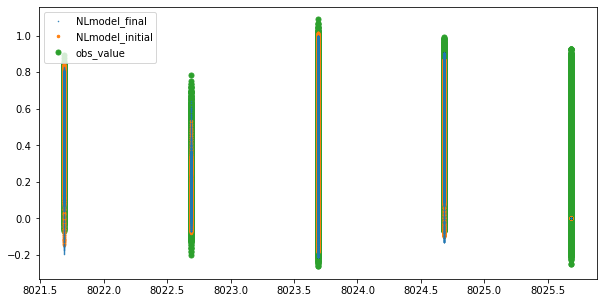

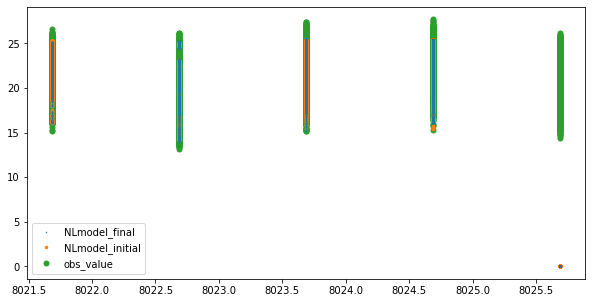

In [72]:

dEnd=8009

pRange=(405)
v=mod.NLmodel_final.where(mod.obs_provenance==pRange)
vi=mod.NLmodel_initial.where(mod.obs_provenance==pRange)
vobs=mod.obs_value.where(mod.obs_provenance==pRange)
lo=mod.obs_lon.where(mod.obs_provenance==pRange)
la=mod.obs_lat.where(mod.obs_provenance==pRange)
t=mod.obs_time.where(mod.obs_provenance==pRange)
fig = plt.figure(figsize=(10,5))
ax = plt.axes()
ax.plot(t, v, marker='.', markersize=1, lineStyle='None',label='NLmodel_final',zorder=10)
ax.plot(t, vi, marker='.', markersize=5, lineStyle='None',label='NLmodel_initial',zorder=5)
ax.plot(t, vobs, marker='.', markersize=10, lineStyle='None',label='obs_value',zorder=1)
ax.legend()
print(v.mean())


pRange=(340)
v=mod.NLmodel_final.where(mod.obs_provenance==pRange)
vi=mod.NLmodel_initial.where(mod.obs_provenance==pRange)
vobs=mod.obs_value.where(mod.obs_provenance==pRange)
lo=mod.obs_lon.where(mod.obs_provenance==pRange)
la=mod.obs_lat.where(mod.obs_provenance==pRange)
t=mod.obs_time.where(mod.obs_provenance==pRange)
fig = plt.figure(figsize=(10,5))
ax = plt.axes()
ax.plot(t, v, marker='.', markersize=1, lineStyle='None',label='NLmodel_final',zorder=10)
ax.plot(t, vi, marker='.', markersize=5, lineStyle='None',label='NLmodel_initial',zorder=5)
ax.plot(t, vobs, marker='.', markersize=10, lineStyle='None',label='obs_value',zorder=1)
ax.legend()
print(v.mean())

# Below is old stuff.

In [74]:
datelist = np.array(range(timeRange[0],timeRange[1],4))

for dates in datelist:
    filenameForecast=hisFilePath+prefixForecast+'0'+str(dates)+'.nc'
    filenameAnalysis=hisFilePath+prefixAnalysis+'0'+str(dates)+'.nc'
    filenameTruth=truthFilePath+prefixTruth+'0'+str(dates)+'.nc'

    sshForecast=xr.open_dataset(filenameForecast).zeta.load()
    sshAnalysis=xr.open_dataset(filenameAnalysis).zeta.load()
    sshTruth=xr.open_dataset(filenameTruth).zeta.load()

#     sstForecast=xr.open_dataset(filenameForecast).temp.isel(s_rho=-1).load()
#     sstAnalysis=xr.open_dataset(filenameAnalysis).temp.isel(s_rho=-1).load()

    for tChunk in range(0,timeOutputMax,timeOutputs):
        ## plot of mean difference over days
        toPlotData = xr.concat((sshAnalysis,sshTruth),'diff').diff(dim='diff').isel(diff=0).isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)
        toPlotData

        fig = plt.figure(figsize=(8,8))
        ax = plt.subplot(1,1,1,projection=ccrs.PlateCarree())
        ax.set_extent([147, 162.5, -42, -25])

        feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
        im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)
        toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')

        im.set_clim([-1,1])
        plt.colorbar(im, pad=0.02, fraction=0.05, aspect=60)

        gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        gl.right_labels = False
        gl.top_labels = False

        date1=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk])
        date2=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk+timeOutputs])
        plt.title('SSH Truth - analysis for file '+str(dates)+' for '+date1+' to '+date2)
        plt.ylabel('deg C')
        plt.tight_layout()
        figName = outFigurePath+'SSHdiff_'+str(dates)+'_day'+str(int(tChunk/timeOutputs+1))+'.png'
        # plt.savefig(figName,format='png',bbox_inches='tight')

<ipython-input-74-3cbfd0e601bd>:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8,8))


IndexError: index 30 is out of bounds for axis 0 with size 25

In [76]:

datelist = np.array(range(timeRange[0],timeRange[1],4))

for dates in datelist:
    filenameForecast=hisFilePath+prefixForecast+'0'+str(dates)+'.nc'
    filenameAnalysis=hisFilePath+prefixAnalysis+'0'+str(dates)+'.nc'

    sshForecast=xr.open_dataset(filenameForecast).zeta.load()
    sshAnalysis=xr.open_dataset(filenameAnalysis).zeta.load()

    fig, axes = plt.subplots(5,figsize=(8,24), subplot_kw={'projection': ccrs.PlateCarree()})
    
    for ax, tChunk in zip(axes, range(0,timeOutputMax,timeOutputs)):
        print(ax)
        ## plot of mean difference over days
        toPlotData = xr.concat((sshForecast,sshAnalysis),'diff').diff(dim='diff').isel(diff=0).isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)

        ax.set_extent([147, 162.5, -42, -25])
        feature = ax.add_feature(Coast, edgecolor='black',facecolor='gray')
        im=toPlotData.plot.pcolormesh('lon_rho','lat_rho',cmap=cmocean.cm.curl, ax=ax, add_colorbar=False)
        toPlotData.plot.contour('lon_rho','lat_rho', ax=ax, colors='black')

        plt.colorbar(im, pad=0.02, fraction=0.05, aspect=60)

        gl = ax.gridlines(draw_labels=True,
                     color='black', alpha=0.2, linestyle='--')
        #gl.xformatter = LONGITUDE_FORMATTER
        #gl.yformatter = LATITUDE_FORMATTER
        gl.right_labels = False
        gl.top_labels = False

        date1=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk])
        date2=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk+timeOutputs])
        plt.title('SSH Analysis - Forecast for file '+str(dates)+' for '+date1+' to '+date2)
        plt.ylabel('deg C')
        plt.tight_layout()
        figName = outFigurePath+'SSHdiff_'+str(dates)+'_day'+str(int(tChunk/timeOutputs+1))+'.png'
        plt.savefig(figName,format='png',bbox_inches='tight')

< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc13bd37a90> >
< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc13bd37a90> >
< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc13bd37a90> >
< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc13bd37a90> >
< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc13bd37a90> >
< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc114d0a540> >
< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc114d0a540> >
< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc114d0a540> >
< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc114d0a540> >
< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc114d0a540> >
< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc1227dfd10> >
< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc1227dfd10> >
< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc1227dfd10> >
< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc1227dfd10> >
< GeoAxes: <cartopy.crs.PlateCarree object at 0x7fc1227dfd10> >
< GeoAxes: <cartopy.crs.PlateCarree obje

IndexError: index 25 is out of bounds for axis 0 with size 25

0
1
2
3
4
<ipython-input-47-89e4b4ad20e0>:41: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
0
1
2
3
4
<ipython-input-47-89e4b4ad20e0>:41: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
0
1
2
3
4
<ipython-input-47-89e4b4ad20e0>:41: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
0
1
2
3
4
<ipython-input-47-89e4b4ad20e0>:41: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
0
1
2
3
4
<ipython-input-47-89e4b4ad20e0>:41: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


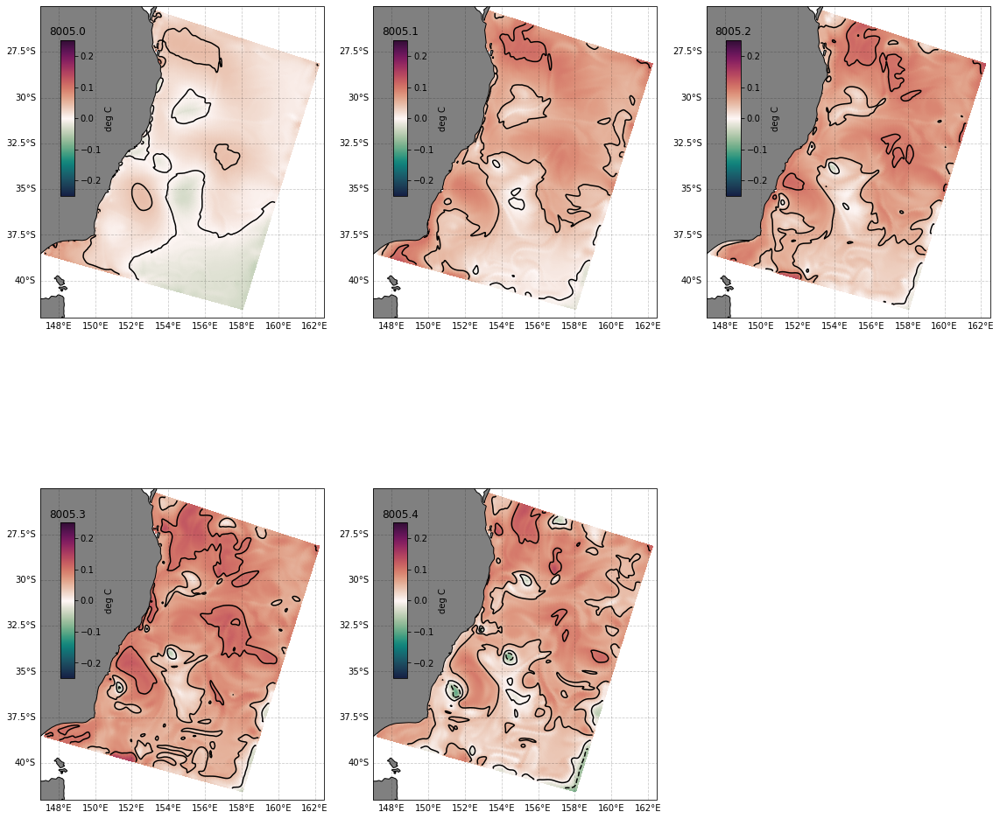

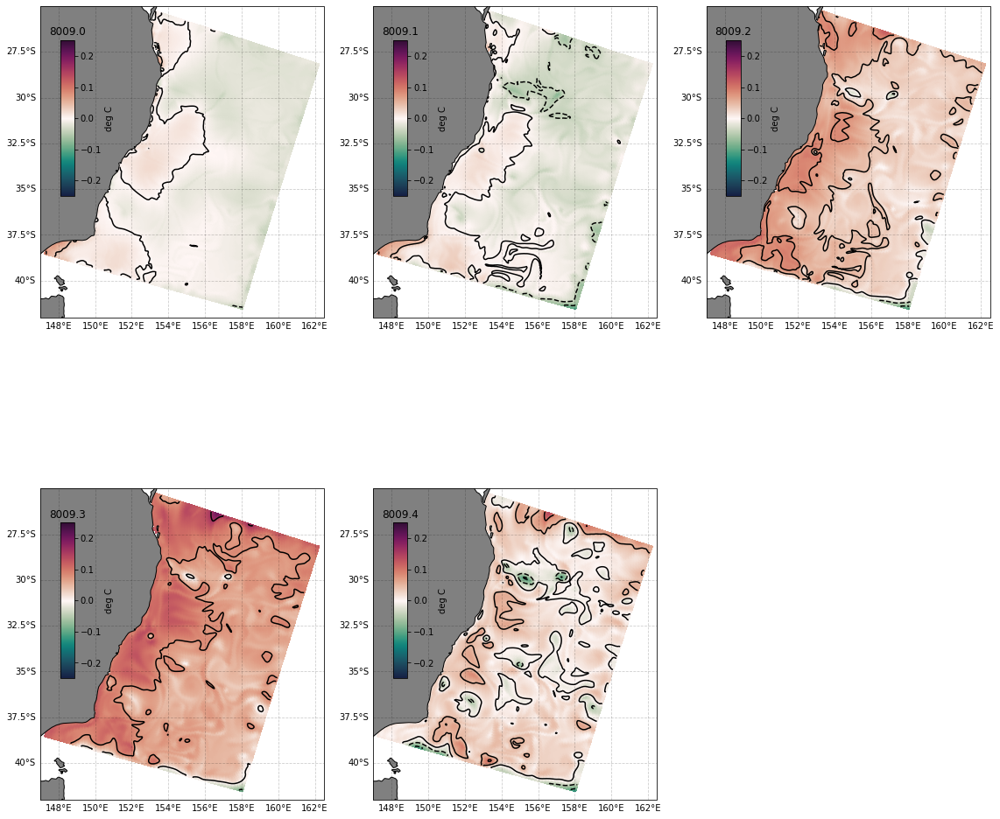

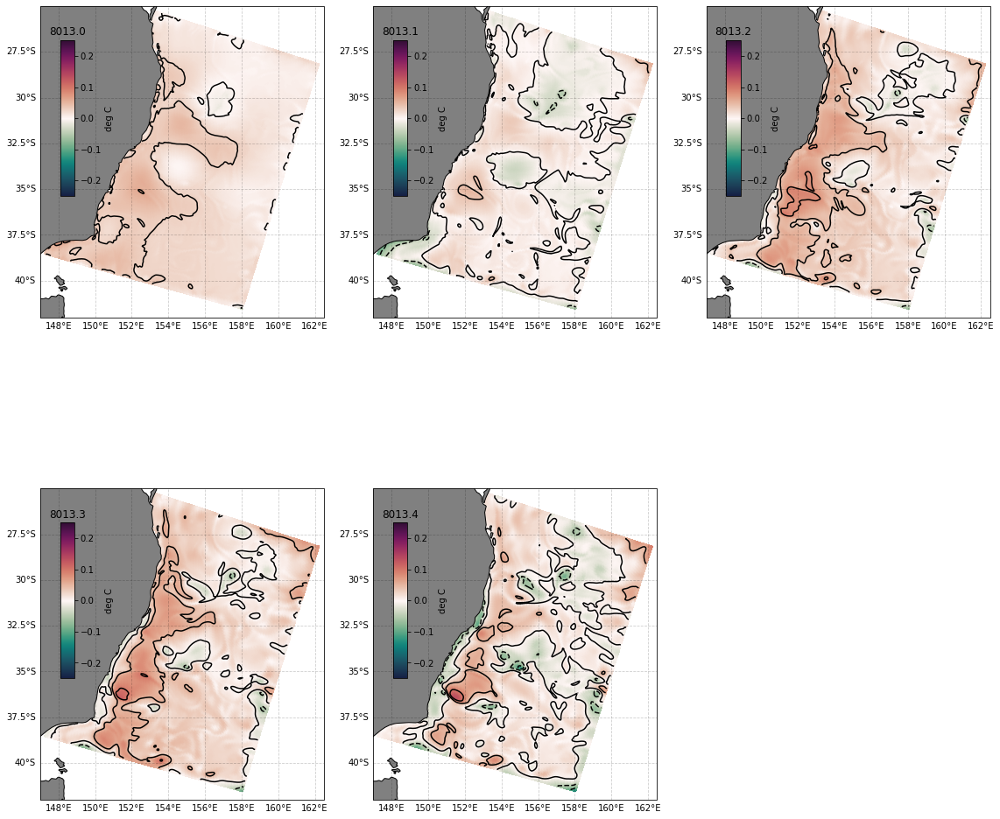

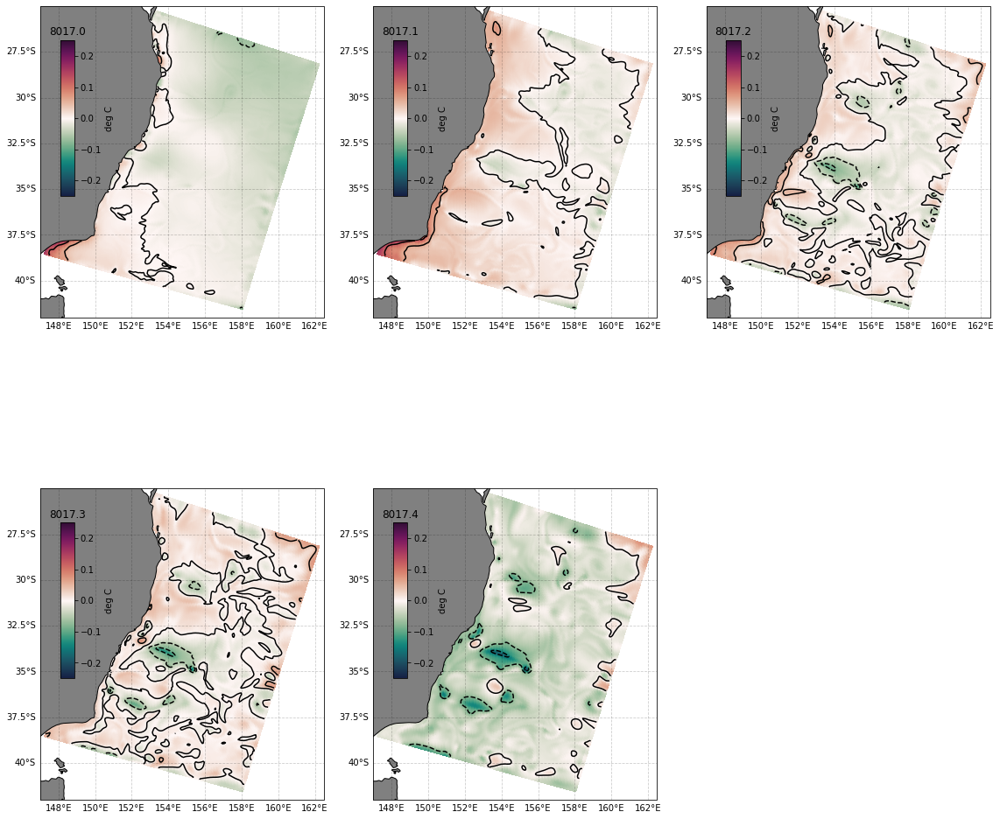

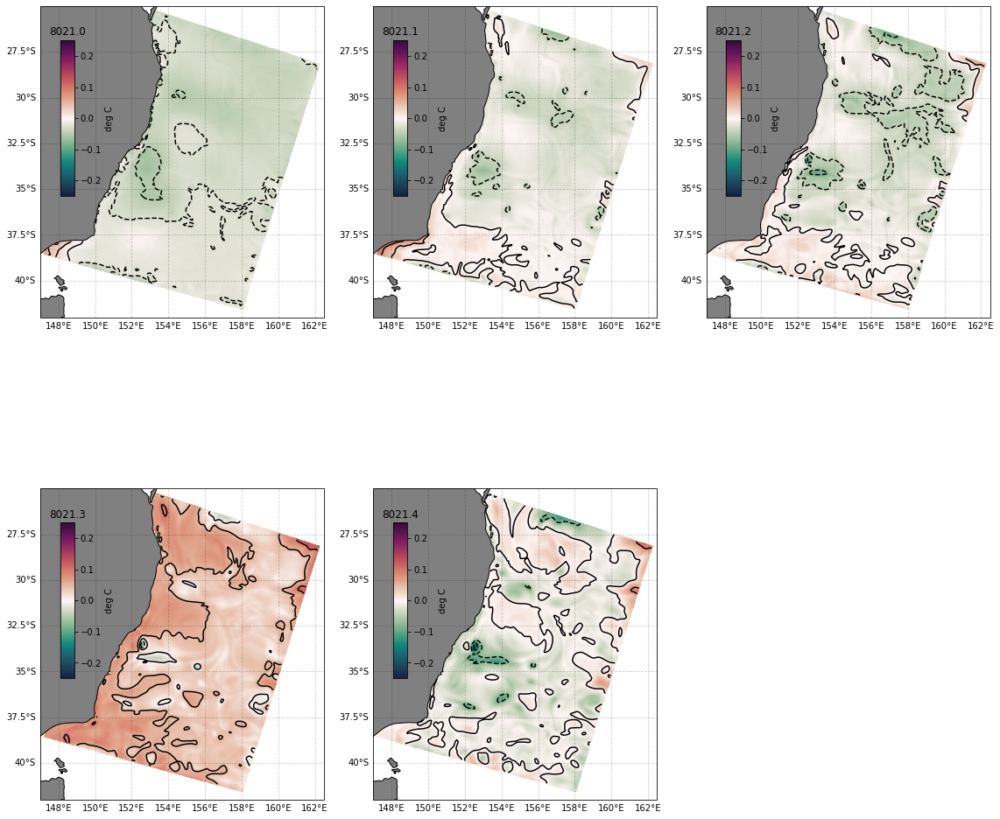

In [47]:


import glob
chunks = {'ocean_time':1}
# filelist = glob.glob(hisFilePath+'roms_fwd_outer1_0800*.nc')
prefixForecast='roms_fwd_outer0_'
prefixAnalysis='roms_fwd_outer1_'

datelist = np.array(range(timeRange[0],timeRange[1],4))

for dates in datelist:
    filenameForecast=hisFilePath+prefixForecast+'0'+str(dates)+'.nc'
    filenameAnalysis=hisFilePath+prefixAnalysis+'0'+str(dates)+'.nc'

    sshForecast=xr.open_dataset(filenameForecast).zeta.load()
    sshAnalysis=xr.open_dataset(filenameAnalysis).zeta.load()

    fig = plt.figure(figsize=(16,16))
    iSz,jSz = (2,3)
    gs = fig.add_gridspec(iSz, jSz)

        
    for ax, tChunk in zip(range(iSz*jSz), range(0,timeOutputMax,timeOutputs)):
        print(ax)
        ## plot of mean difference over days
        toPlotData = xr.concat((sshForecast,sshAnalysis),'diff').diff(dim='diff').isel(diff=0).isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)

        pcol_params={"cmap":"cmo.curl","vmin":-.25, "vmax":.25}#, "add_colorbar":"False"}
        cont_params={"colors":"black"}
        # ax.set_extent([147, 162.5, -42, -25])
        # Plotting
        simple_spatial_plot(toPlotData, ax=ax,pcol_kwargs=pcol_params, cont_kwargs=cont_params)

        # fig.subplots_adjust(right=0.8)
        # cbar_ax = fig.add_axes([0.85, 0.15, 0.05, 0.35])
        # fig.colorbar(im, cax=cbar_ax)

        date1=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk])
        date2=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk+timeOutputs])
        # plt.title('SSH Analysis - Forecast for file '+str(dates)+' for '+date1+' to '+date2)
        plt.title(str(dates)+'.'+str(ax))
        plt.ylabel('deg C')
    plt.tight_layout()
    figName = outFigurePath+'SSHdiff_'+str(dates)+'.png'
    # plt.savefig(figName,format='png',bbox_inches='tight')

0
1
2
3
4
<ipython-input-48-0acec4bce535>:37: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
0
1
2
3
4
<ipython-input-48-0acec4bce535>:37: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
0
1
2
3
4
<ipython-input-48-0acec4bce535>:37: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
0
1
2
3
4
<ipython-input-48-0acec4bce535>:37: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
0
1
2
3
4
<ipython-input-48-0acec4bce535>:37: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


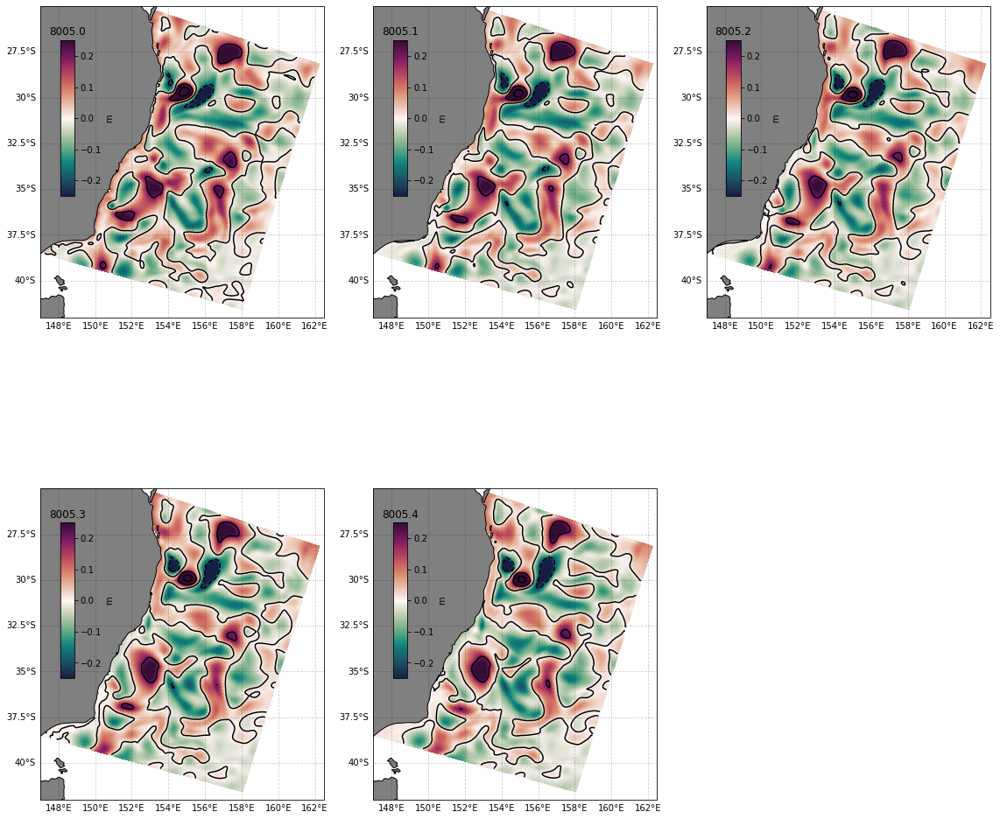

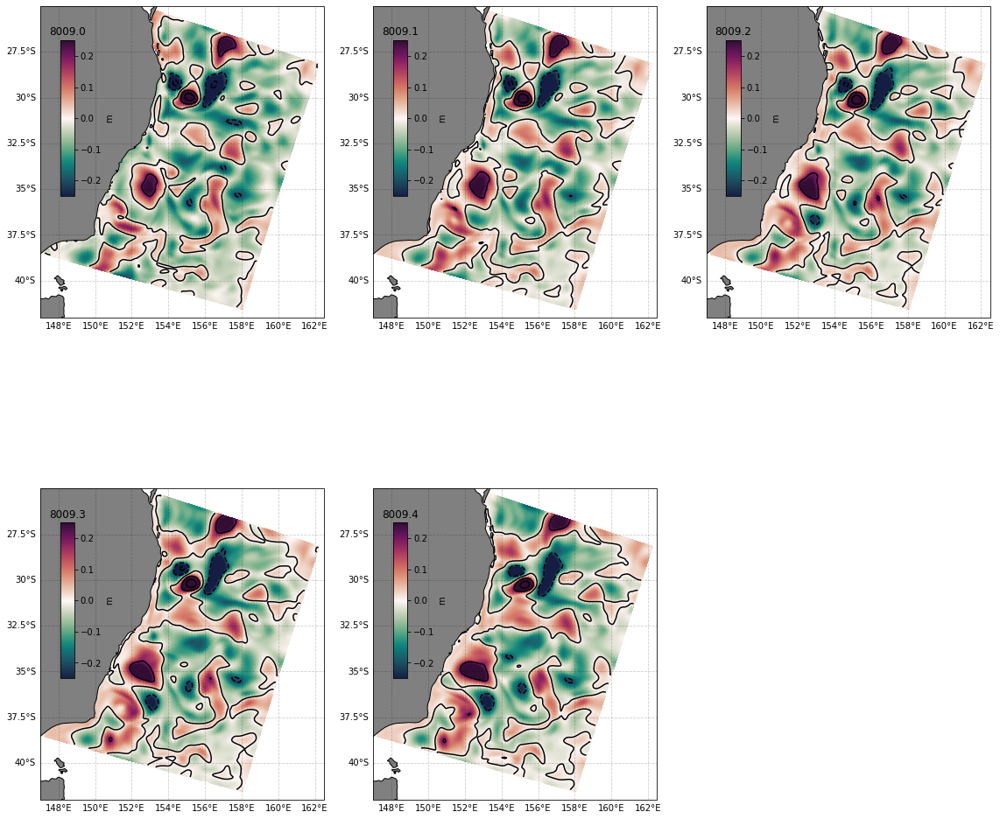

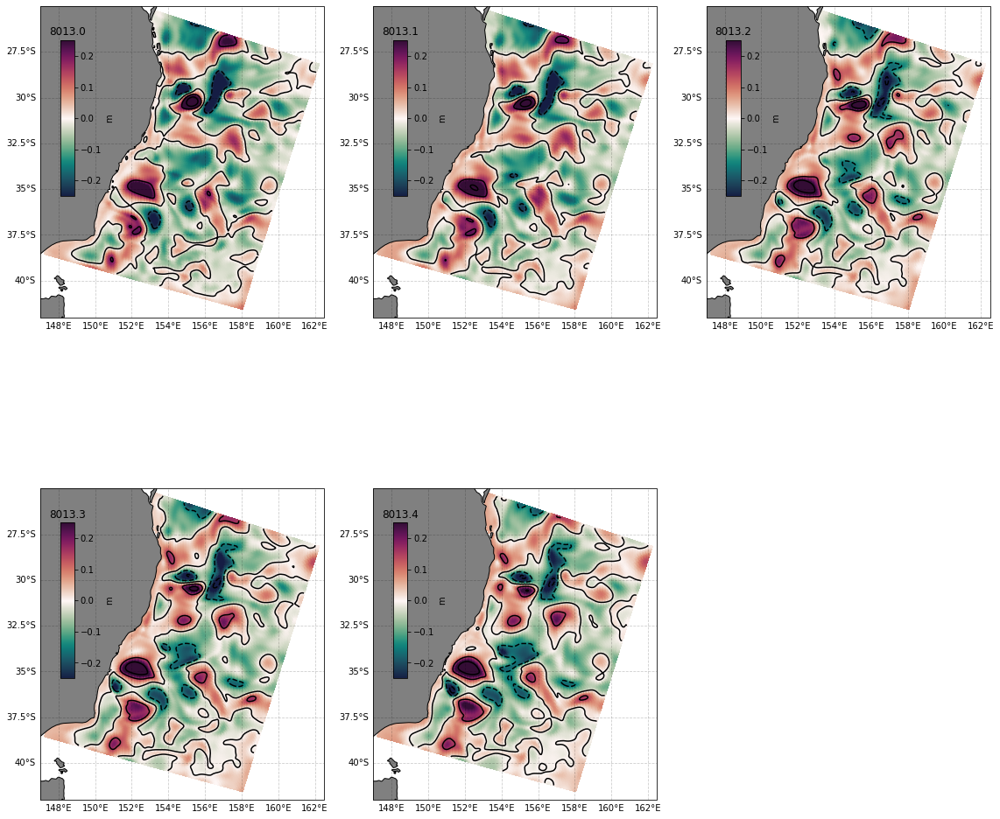

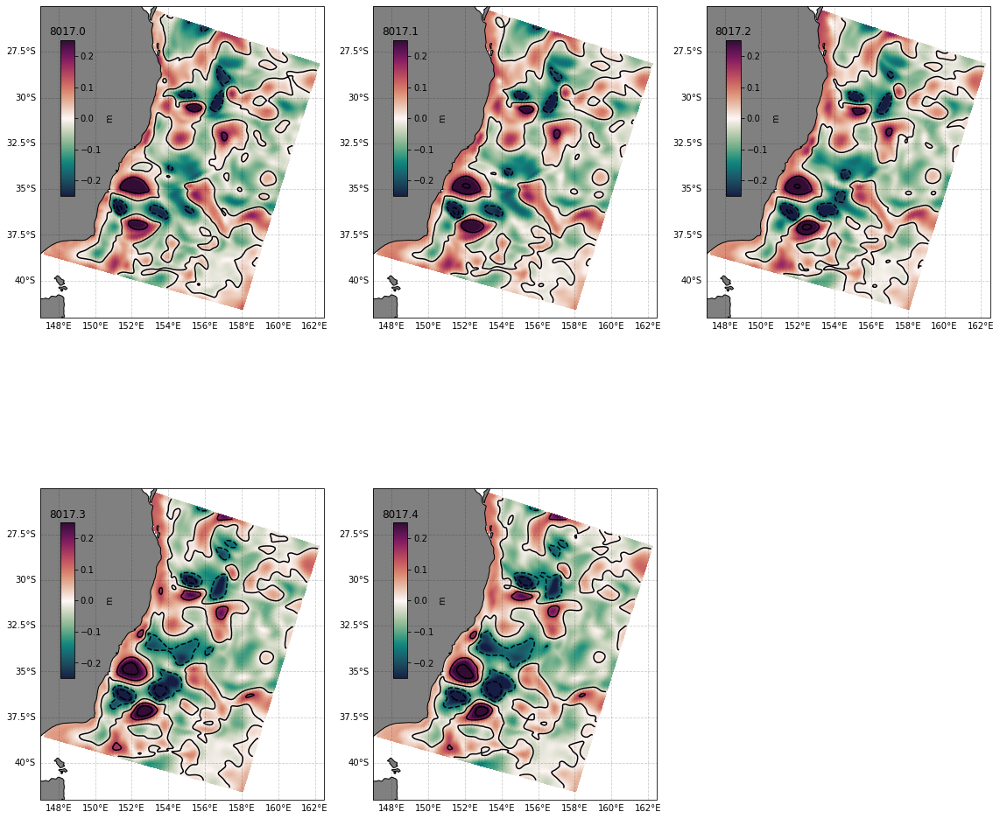

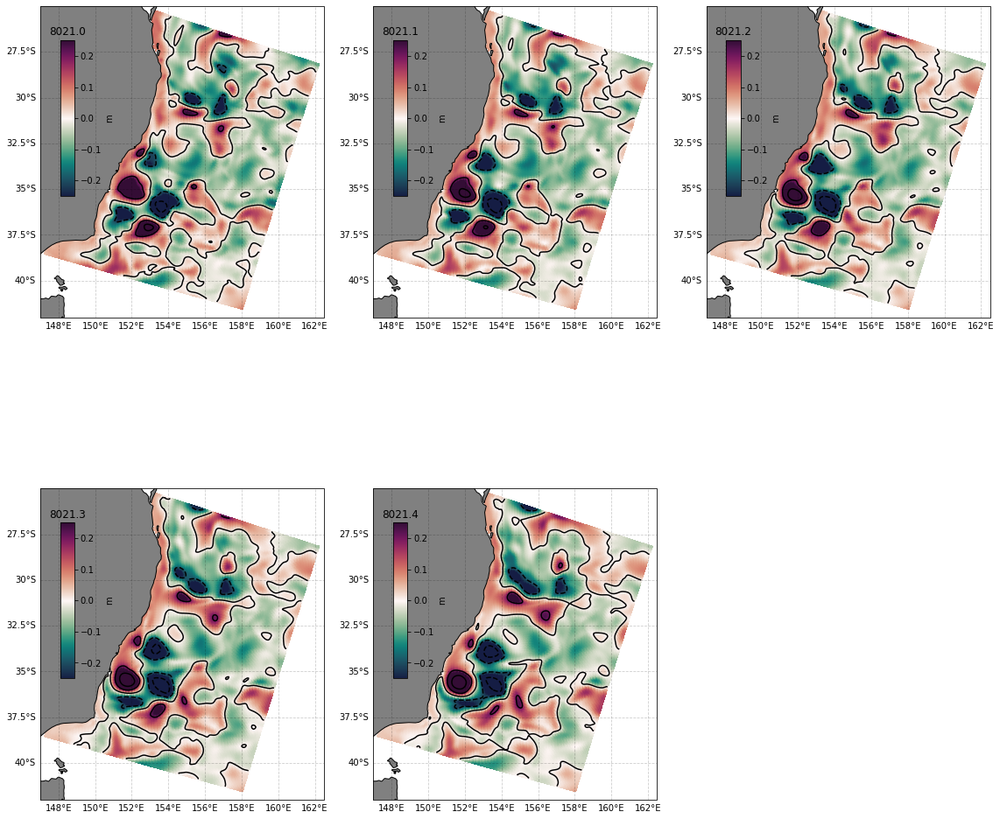

In [48]:

datelist = np.array(range(timeRange[0],timeRange[1],4))

for dates in datelist:
    filenameForecast=hisFilePath+prefixForecast+'0'+str(dates)+'.nc'
    filenameAnalysis=hisFilePath+prefixAnalysis+'0'+str(dates)+'.nc'
    filenameTruth   =truthFilePath+prefixTruth+'0'+str(dates)+'.nc'

    sshTruth   =xr.open_dataset(filenameTruth).zeta.load()
    sshForecast=xr.open_dataset(filenameForecast).zeta.load()
    sshAnalysis=xr.open_dataset(filenameAnalysis).zeta.load()

    fig = plt.figure(figsize=(16,16))
    iSz,jSz = (2,3)
    gs = fig.add_gridspec(iSz, jSz)

        
    for ax, tChunk in zip(range(iSz*jSz), range(0,timeOutputMax,timeOutputs)):
        print(ax)
        ## plot of mean difference over days
        toPlotData = xr.concat((sshForecast,sshTruth),'diff').diff(dim='diff').isel(diff=0).isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)

        pcol_params={"cmap":"cmo.curl","vmin":-.25, "vmax":.25}#, "add_colorbar":"False"}
        cont_params={"colors":"black"}
        # ax.set_extent([147, 162.5, -42, -25])
        # Plotting
        simple_spatial_plot(toPlotData, ax=ax,pcol_kwargs=pcol_params, cont_kwargs=cont_params)

        # fig.subplots_adjust(right=0.8)
        # cbar_ax = fig.add_axes([0.85, 0.15, 0.05, 0.35])
        # fig.colorbar(im, cax=cbar_ax)

        date1=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk])
        date2=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk+timeOutputs])
        # plt.title('SSH Analysis - Forecast for file '+str(dates)+' for '+date1+' to '+date2)
        plt.title(str(dates)+'.'+str(ax))
        plt.ylabel('m')
    plt.tight_layout()
    figName = outFigurePath+'SSHdiff_'+str(dates)+'.png'
    # plt.savefig(figName,format='png',bbox_inches='tight')

0
1
2
3
4
<ipython-input-49-9307ff7650e1>:37: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
0
1
2
3
4
<ipython-input-49-9307ff7650e1>:37: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
0
1
2
3
4
<ipython-input-49-9307ff7650e1>:37: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
0
1
2
3
4
<ipython-input-49-9307ff7650e1>:37: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
0
1
2
3
4
<ipython-input-49-9307ff7650e1>:37: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


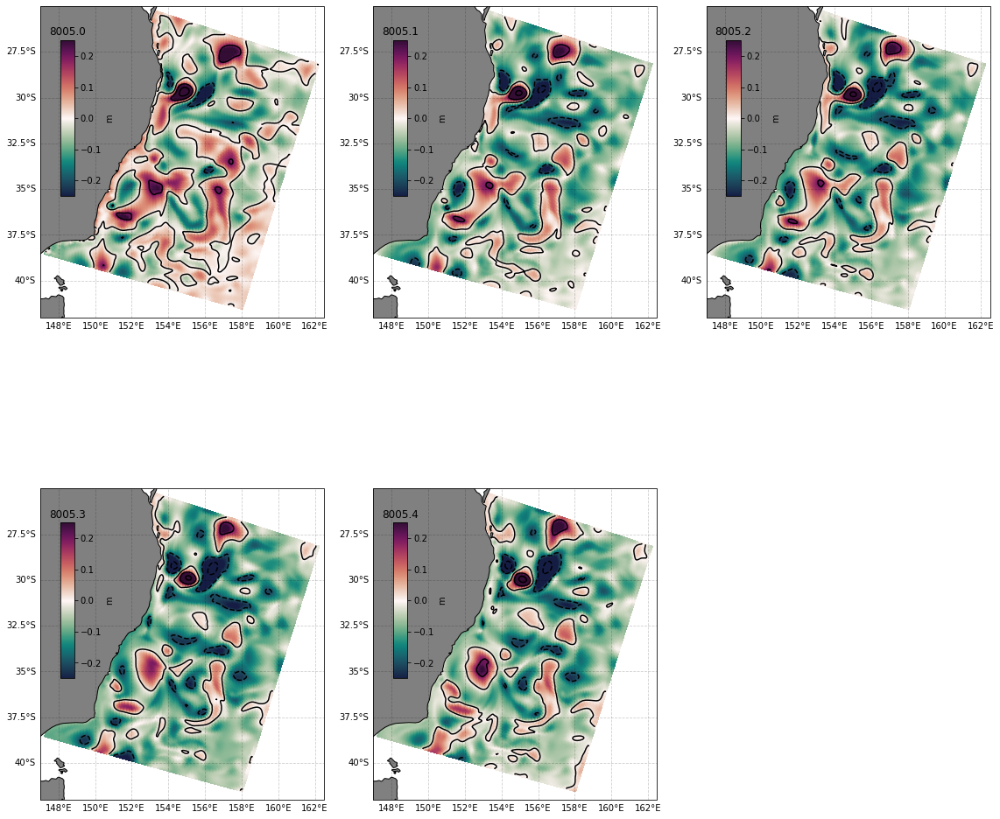

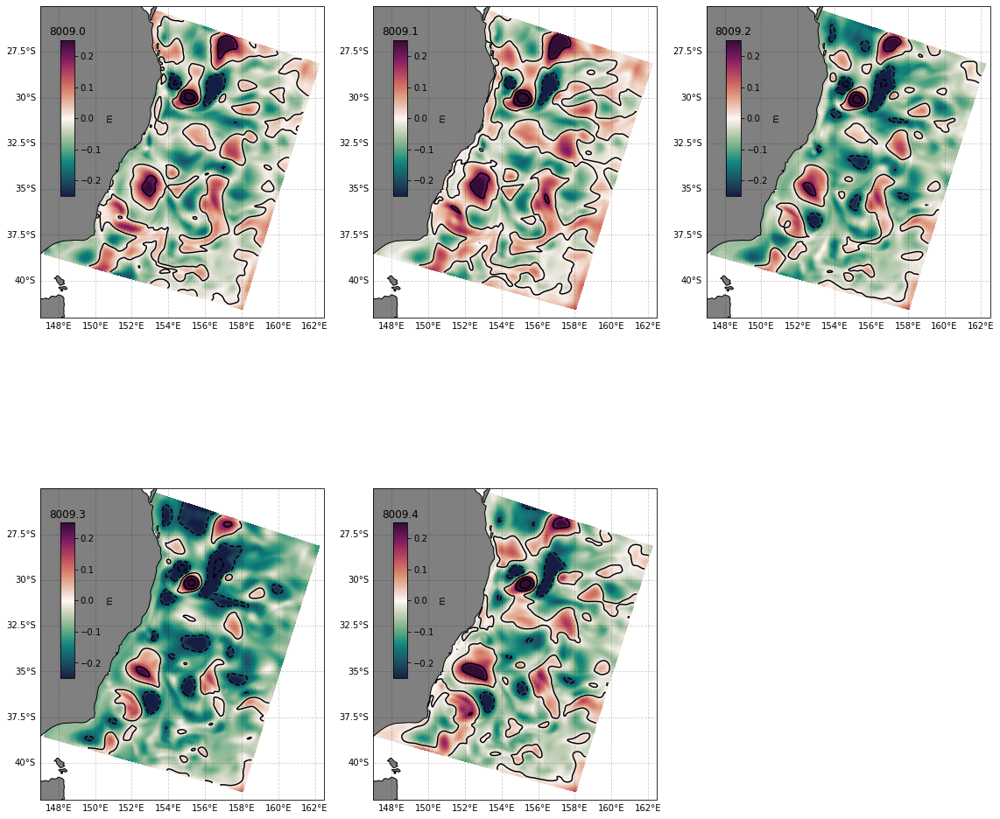

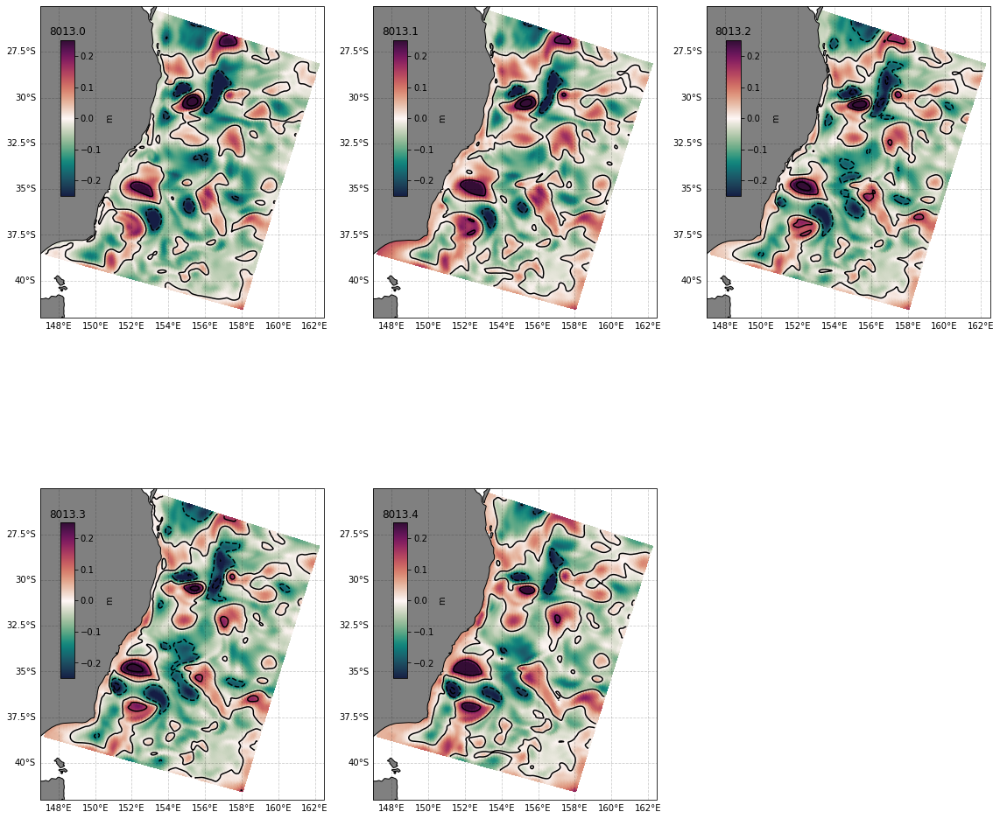

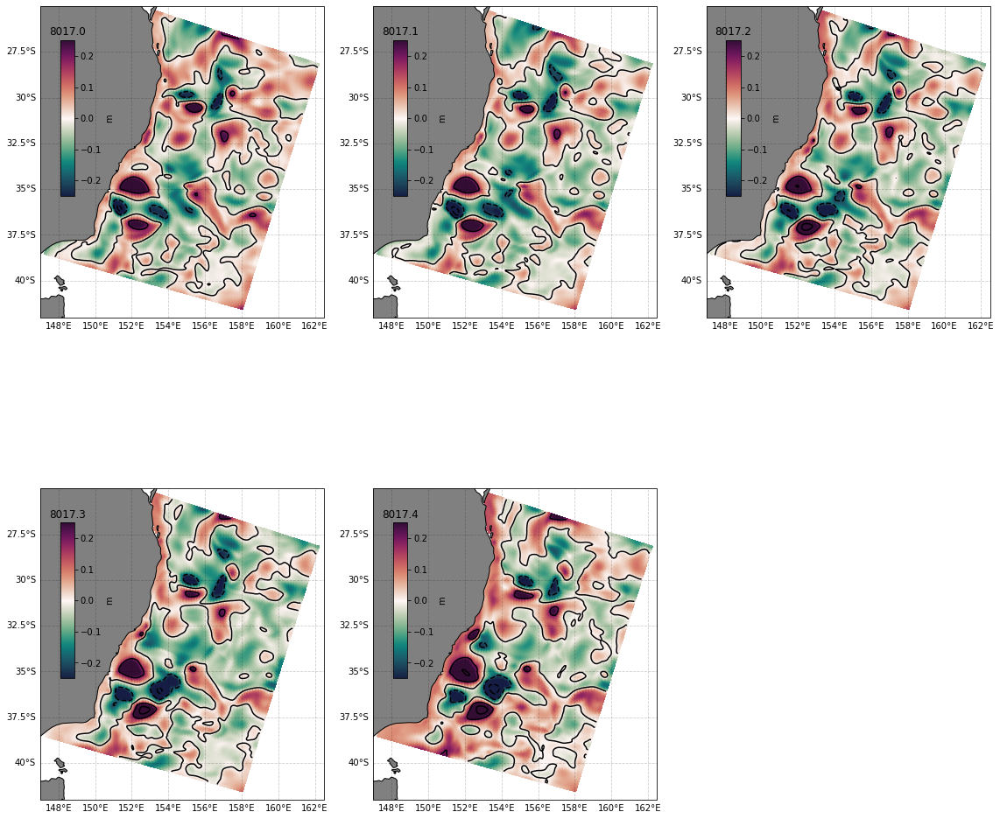

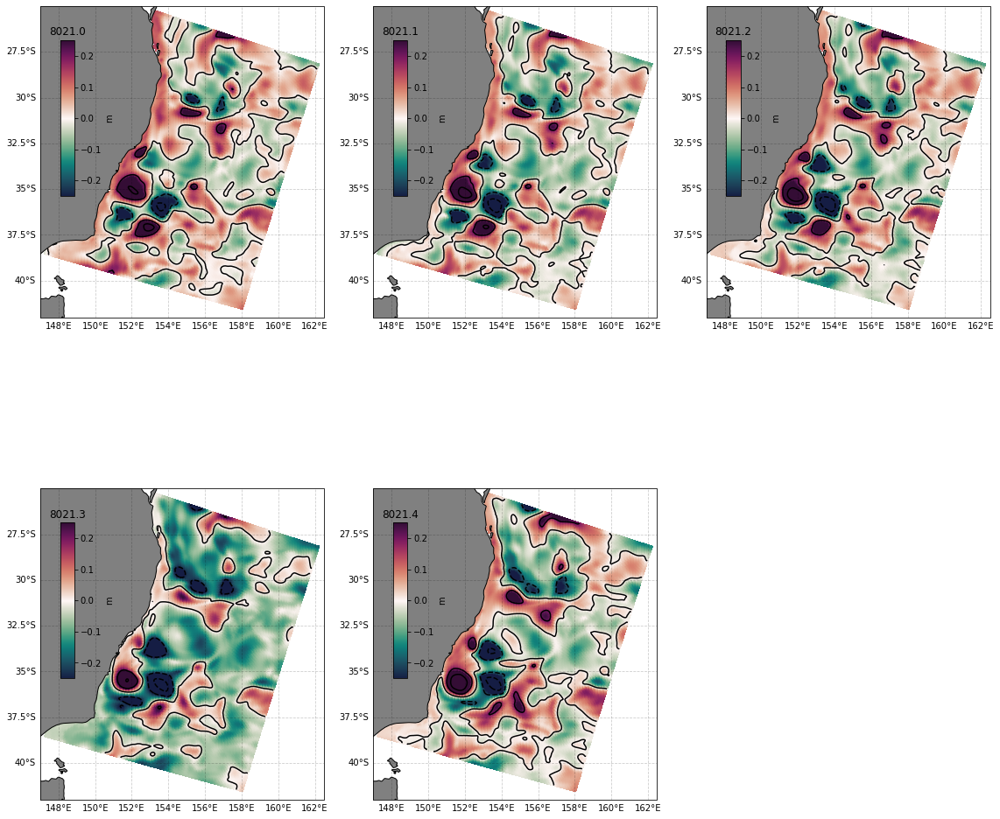

In [49]:

datelist = np.array(range(timeRange[0],timeRange[1],4))

for dates in datelist:
    filenameForecast=hisFilePath+prefixForecast+'0'+str(dates)+'.nc'
    filenameAnalysis=hisFilePath+prefixAnalysis+'0'+str(dates)+'.nc'
    filenameTruth   =truthFilePath+prefixTruth+'0'+str(dates)+'.nc'

    sshTruth   =xr.open_dataset(filenameTruth).zeta.load()
    sshForecast=xr.open_dataset(filenameForecast).zeta.load()
    sshAnalysis=xr.open_dataset(filenameAnalysis).zeta.load()

    fig = plt.figure(figsize=(16,16))
    iSz,jSz = (2,3)
    gs = fig.add_gridspec(iSz, jSz)

        
    for ax, tChunk in zip(range(iSz*jSz), range(0,timeOutputMax,timeOutputs)):
        print(ax)
        ## plot of mean difference over days
        toPlotData = xr.concat((sshAnalysis,sshTruth),'diff').diff(dim='diff').isel(diff=0).isel(ocean_time=np.arange(tChunk,tChunk+timeOutputs)).mean(dim='ocean_time',skipna=True)

        pcol_params={"cmap":"cmo.curl","vmin":-.25, "vmax":.25}#, "add_colorbar":"False"}
        cont_params={"colors":"black"}
        # ax.set_extent([147, 162.5, -42, -25])
        # Plotting
        simple_spatial_plot(toPlotData, ax=ax,pcol_kwargs=pcol_params, cont_kwargs=cont_params)

        # fig.subplots_adjust(right=0.8)
        # cbar_ax = fig.add_axes([0.85, 0.15, 0.05, 0.35])
        # fig.colorbar(im, cax=cbar_ax)

        date1=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk])
        date2=np.datetime_as_string(sshForecast.coords['ocean_time'].values[tChunk+timeOutputs])
        # plt.title('SSH Analysis - Forecast for file '+str(dates)+' for '+date1+' to '+date2)
        plt.title(str(dates)+'.'+str(ax))
        plt.ylabel('m')
    plt.tight_layout()
    figName = outFigurePath+'SSHdiff_'+str(dates)+'.png'
    # plt.savefig(figName,format='png',bbox_inches='tight')